In [1]:
import warnings
warnings.filterwarnings(action='ignore')

import plotly.express as px

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn import linear_model
from sklearn.svm import SVR
from sklearn import ensemble
from sklearn import metrics
from sklearn.model_selection import GridSearchCV



In [2]:
data = pd.read_csv(r'C:\\Users\\risha\\Downloads\\Capstone Project\Supply Chain Project\Data.csv')

In [3]:
data.head()

,Ware_house_ID,WH_Manager_ID,Location_type,WH_capacity_size,zone,WH_regional_zone,num_refill_req_l3m,transport_issue_l1y,Competitor_in_mkt,retail_shop_num,...,electric_supply,dist_from_hub,workers_num,wh_est_year,storage_issue_reported_l3m,temp_reg_mach,approved_wh_govt_certificate,wh_breakdown_l3m,govt_check_l3m,product_wg_ton
0,WH_100000,EID_50000,Urban,Small,West,Zone 6,3,1,2,4651,...,1,91,29.0,NaN,13,0,A,5,15,17115
1,WH_100001,EID_50001,Rural,Large,North,Zone 5,0,0,4,6217,...,1,210,31.0,NaN,4,0,A,3,17,5074
2,WH_100002,EID_50002,Rural,Mid,South,Zone 2,1,0,4,4306,...,0,161,37.0,NaN,17,0,A,6,22,23137
3,WH_100003,EID_50003,Rural,Mid,North,Zone 3,7,4,2,6000,...,0,103,21.0,NaN,17,1,A+,3,27,22115
4,WH_100004,EID_50004,Rural,Large,North,Zone 5,3,1,2,4740,...,1,112,25.0,2009.0,18,0,C,6,24,24071


In [4]:
def check_data(data):
    print('Number of data points : ', data.shape[0])
    print('Number of features/columns : ', data.shape[1], '\n', '--'*50)
    print('Features : ', data.columns.values)

In [5]:
check_data(data)


Number of data points :  25000
Number of features/columns :  24 
 ----------------------------------------------------------------------------------------------------
Features :  ['Ware_house_ID' 'WH_Manager_ID' 'Location_type' 'WH_capacity_size' 'zone'
 'WH_regional_zone' 'num_refill_req_l3m' 'transport_issue_l1y'
 'Competitor_in_mkt' 'retail_shop_num' 'wh_owner_type' 'distributor_num'
 'flood_impacted' 'flood_proof' 'electric_supply' 'dist_from_hub'
 'workers_num' 'wh_est_year' 'storage_issue_reported_l3m' 'temp_reg_mach'
 'approved_wh_govt_certificate' 'wh_breakdown_l3m' 'govt_check_l3m'
 'product_wg_ton']


In [6]:
# Analyze numerical columns
numerical_cols = ['num_refill_req_l3m', 'transport_issue_l1y', 'Competitor_in_mkt',
                 'retail_shop_num', 'distributor_num', 'dist_from_hub', 'workers_num',
                 'wh_breakdown_l3m', 'govt_check_l3m', 'product_wg_ton']
print("\nNumerical variables summary:")
print(data[numerical_cols].describe())


Numerical variables summary:
       num_refill_req_l3m  transport_issue_l1y  Competitor_in_mkt  \
count        25000.000000         25000.000000       25000.000000   
mean             4.089040             0.773680           3.104200   
std              2.606612             1.199449           1.141663   
min              0.000000             0.000000           0.000000   
25%              2.000000             0.000000           2.000000   
50%              4.000000             0.000000           3.000000   
75%              6.000000             1.000000           4.000000   
max              8.000000             5.000000          12.000000   

       retail_shop_num  distributor_num  dist_from_hub   workers_num  \
count     25000.000000     25000.000000   25000.000000  24010.000000   
mean       4985.711560        42.418120     163.537320     28.944398   
std        1052.825252        16.064329      62.718609      7.872534   
min        1821.000000        15.000000      55.000000     1

In [7]:
# Check unique values in categorical columns
categorical_cols = ['Location_type', 'WH_capacity_size', 'zone', 'WH_regional_zone', 
                   'wh_owner_type', 'approved_wh_govt_certificate']
for col in categorical_cols:
    print(f"\nUnique values in {col}:")
    print(data[col].value_counts())


Unique values in Location_type:
Location_type
Rural    22957
Urban     2043
Name: count, dtype: int64

Unique values in WH_capacity_size:
WH_capacity_size
Large    10169
Mid      10020
Small     4811
Name: count, dtype: int64

Unique values in zone:
zone
North    10278
West      7931
South     6362
East       429
Name: count, dtype: int64

Unique values in WH_regional_zone:
WH_regional_zone
Zone 6    8339
Zone 5    4587
Zone 4    4176
Zone 2    2963
Zone 3    2881
Zone 1    2054
Name: count, dtype: int64

Unique values in wh_owner_type:
wh_owner_type
Company Owned    13578
Rented           11422
Name: count, dtype: int64

Unique values in approved_wh_govt_certificate:
approved_wh_govt_certificate
C     5501
B+    4917
B     4812
A     4671
A+    4191
Name: count, dtype: int64


In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25000 entries, 0 to 24999
Data columns (total 24 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Ware_house_ID                 25000 non-null  object 
 1   WH_Manager_ID                 25000 non-null  object 
 2   Location_type                 25000 non-null  object 
 3   WH_capacity_size              25000 non-null  object 
 4   zone                          25000 non-null  object 
 5   WH_regional_zone              25000 non-null  object 
 6   num_refill_req_l3m            25000 non-null  int64  
 7   transport_issue_l1y           25000 non-null  int64  
 8   Competitor_in_mkt             25000 non-null  int64  
 9   retail_shop_num               25000 non-null  int64  
 10  wh_owner_type                 25000 non-null  object 
 11  distributor_num               25000 non-null  int64  
 12  flood_impacted                25000 non-null  int64  
 13  f

In [9]:
data.describe().round(2)

,num_refill_req_l3m,transport_issue_l1y,Competitor_in_mkt,retail_shop_num,distributor_num,flood_impacted,flood_proof,electric_supply,dist_from_hub,workers_num,wh_est_year,storage_issue_reported_l3m,temp_reg_mach,wh_breakdown_l3m,govt_check_l3m,product_wg_ton
count,25000.00,25000.00,25000.00,25000.00,25000.00,25000.0,25000.00,25000.00,25000.00,24010.00,13119.00,25000.00,25000.00,25000.00,25000.00,25000.00
mean,4.09,0.77,3.10,4985.71,42.42,0.1,0.05,0.66,163.54,28.94,2009.38,17.13,0.30,3.48,18.81,22102.63
std,2.61,1.20,1.14,1052.83,16.06,0.3,0.23,0.47,62.72,7.87,7.53,9.16,0.46,1.69,8.63,11607.76
min,0.00,0.00,0.00,1821.00,15.00,0.0,0.00,0.00,55.00,10.00,1996.00,0.00,0.00,0.00,1.00,2065.00
25%,2.00,0.00,2.00,4313.00,29.00,0.0,0.00,0.00,109.00,24.00,2003.00,10.00,0.00,2.00,11.00,13059.00
50%,4.00,0.00,3.00,4859.00,42.00,0.0,0.00,1.00,164.00,28.00,2009.00,18.00,0.00,3.00,21.00,22101.00
75%,6.00,1.00,4.00,5500.00,56.00,0.0,0.00,1.00,218.00,33.00,2016.00,24.00,1.00,5.00,26.00,30103.00
max,8.00,5.00,12.00,11008.00,70.00,1.0,1.00,1.00,271.00,98.00,2023.00,39.00,1.00,6.00,32.00,55151.00


In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25000 entries, 0 to 24999
Data columns (total 24 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Ware_house_ID                 25000 non-null  object 
 1   WH_Manager_ID                 25000 non-null  object 
 2   Location_type                 25000 non-null  object 
 3   WH_capacity_size              25000 non-null  object 
 4   zone                          25000 non-null  object 
 5   WH_regional_zone              25000 non-null  object 
 6   num_refill_req_l3m            25000 non-null  int64  
 7   transport_issue_l1y           25000 non-null  int64  
 8   Competitor_in_mkt             25000 non-null  int64  
 9   retail_shop_num               25000 non-null  int64  
 10  wh_owner_type                 25000 non-null  object 
 11  distributor_num               25000 non-null  int64  
 12  flood_impacted                25000 non-null  int64  
 13  f

**Data Preprocessing -**

In [11]:
data.drop(columns=['Ware_house_ID', 'WH_Manager_ID'], inplace = True)

In [12]:
data.isnull().sum()

Location_type                       0
WH_capacity_size                    0
zone                                0
WH_regional_zone                    0
num_refill_req_l3m                  0
transport_issue_l1y                 0
Competitor_in_mkt                   0
retail_shop_num                     0
wh_owner_type                       0
distributor_num                     0
flood_impacted                      0
flood_proof                         0
electric_supply                     0
dist_from_hub                       0
workers_num                       990
wh_est_year                     11881
storage_issue_reported_l3m          0
temp_reg_mach                       0
approved_wh_govt_certificate      908
wh_breakdown_l3m                    0
govt_check_l3m                      0
product_wg_ton                      0
dtype: int64

In [13]:
print('Feature name |', 'No. of null values = ', '% of null values', '\n')
for f in ['workers_num', 'wh_est_year', 'approved_wh_govt_certificate']:
    null_count = data[f].isna().sum()
    null_percent = round((null_count/len(data))*100, 2) 
    print(f'{f: <25} | {null_count: <4} = {null_percent: <6}%')

Feature name | No. of null values =  % of null values 

workers_num               | 990  = 3.96  %
wh_est_year               | 11881 = 47.52 %
approved_wh_govt_certificate | 908  = 3.63  %


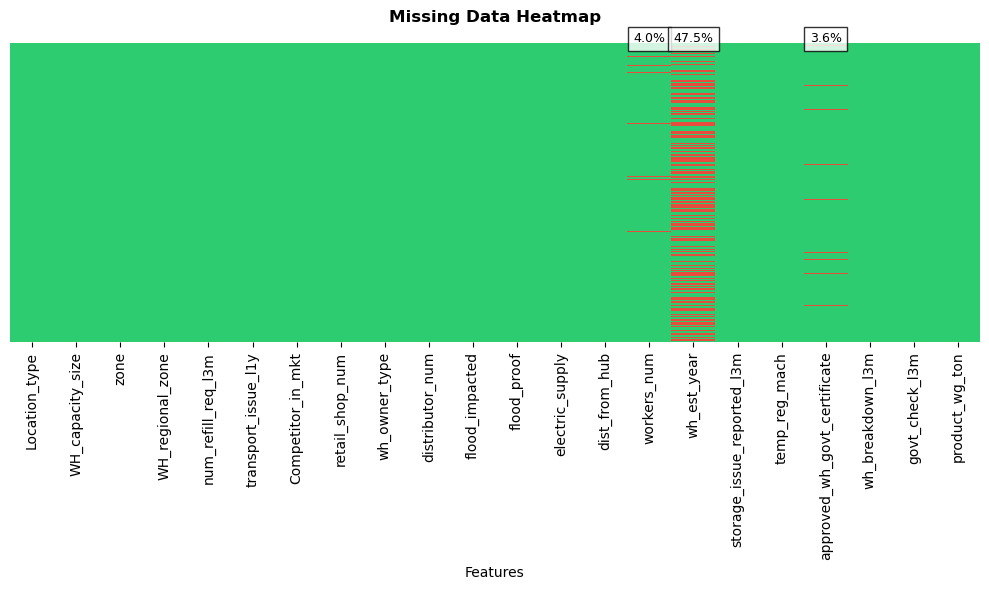

In [14]:
plt.figure(figsize=(10,6))
ax = sns.heatmap(data.isnull(), cbar=False, 
                cmap=['#2ecc71','#e74c3c'], 
                yticklabels=False)

# Add annotations
for i, col in enumerate(data.columns):
    if data[col].isna().any():
        ax.text(i+0.5, -50, f"{data[col].isna().mean():.1%}", 
               ha='center', fontsize=9,
               bbox=dict(facecolor='white', alpha=0.8))

plt.title("Missing Data Heatmap", pad=15, fontweight='bold')
plt.xlabel("Features")
plt.tight_layout()
plt.show()

In [15]:
data.drop(columns=['wh_est_year'], inplace = True)

##dropping column

In [16]:
data.isnull().sum()

Location_type                     0
WH_capacity_size                  0
zone                              0
WH_regional_zone                  0
num_refill_req_l3m                0
transport_issue_l1y               0
Competitor_in_mkt                 0
retail_shop_num                   0
wh_owner_type                     0
distributor_num                   0
flood_impacted                    0
flood_proof                       0
electric_supply                   0
dist_from_hub                     0
workers_num                     990
storage_issue_reported_l3m        0
temp_reg_mach                     0
approved_wh_govt_certificate    908
wh_breakdown_l3m                  0
govt_check_l3m                    0
product_wg_ton                    0
dtype: int64

In [17]:
data['workers_num'].median()

28.0

In [18]:
data['workers_num'].fillna(data['workers_num'].median(), inplace=True)

In [19]:
data['approved_wh_govt_certificate'].mode()

0    C
Name: approved_wh_govt_certificate, dtype: object

In [20]:
data['approved_wh_govt_certificate'].fillna(data['approved_wh_govt_certificate'].mode()[0], inplace=True)

In [21]:
data.isnull().sum()

Location_type                   0
WH_capacity_size                0
zone                            0
WH_regional_zone                0
num_refill_req_l3m              0
transport_issue_l1y             0
Competitor_in_mkt               0
retail_shop_num                 0
wh_owner_type                   0
distributor_num                 0
flood_impacted                  0
flood_proof                     0
electric_supply                 0
dist_from_hub                   0
workers_num                     0
storage_issue_reported_l3m      0
temp_reg_mach                   0
approved_wh_govt_certificate    0
wh_breakdown_l3m                0
govt_check_l3m                  0
product_wg_ton                  0
dtype: int64

In [22]:
print('Number of Duplicates =', data.duplicated().sum().sum())

Number of Duplicates = 0


In [23]:
data.isnull().sum().sum()

0

In [24]:
data.nunique()

Location_type                      2
WH_capacity_size                   3
zone                               4
WH_regional_zone                   6
num_refill_req_l3m                 9
transport_issue_l1y                6
Competitor_in_mkt                 12
retail_shop_num                 4906
wh_owner_type                      2
distributor_num                   56
flood_impacted                     2
flood_proof                        2
electric_supply                    2
dist_from_hub                    217
workers_num                       60
storage_issue_reported_l3m        37
temp_reg_mach                      2
approved_wh_govt_certificate       5
wh_breakdown_l3m                   7
govt_check_l3m                    32
product_wg_ton                  4561
dtype: int64

**Outlier treatment-**

In [25]:
def treat_outlier_for_numerical_features(column):
    Q1=np.nanpercentile(data[column],25)
    Q2=np.nanpercentile(data[column],50)
    Q3=np.nanpercentile(data[column],75)
    IQR=Q3-Q1
    lower_limit=Q1-1.5*IQR
    upper_limit=Q3+1.5*IQR
    data[column] = np.where(data[column] > upper_limit, upper_limit,data[column])
    data[column] = np.where(data[column] < lower_limit, lower_limit,data[column])

In [26]:
columns_to_plot_numerical = [
    'num_refill_req_l3m',
    'transport_issue_l1y',
    'Competitor_in_mkt',
    'retail_shop_num',
    'distributor_num',
    'flood_impacted',
    'flood_proof',
    'electric_supply',
    'dist_from_hub',
    'workers_num',
    'storage_issue_reported_l3m',
    'temp_reg_mach',
    'wh_breakdown_l3m',
    'govt_check_l3m',
    'product_wg_ton']

plt.show()
for col in columns_to_plot_numerical:
    treat_outlier_for_numerical_features(col)

*Again check the distribution of numerical features after treatment of outliers*

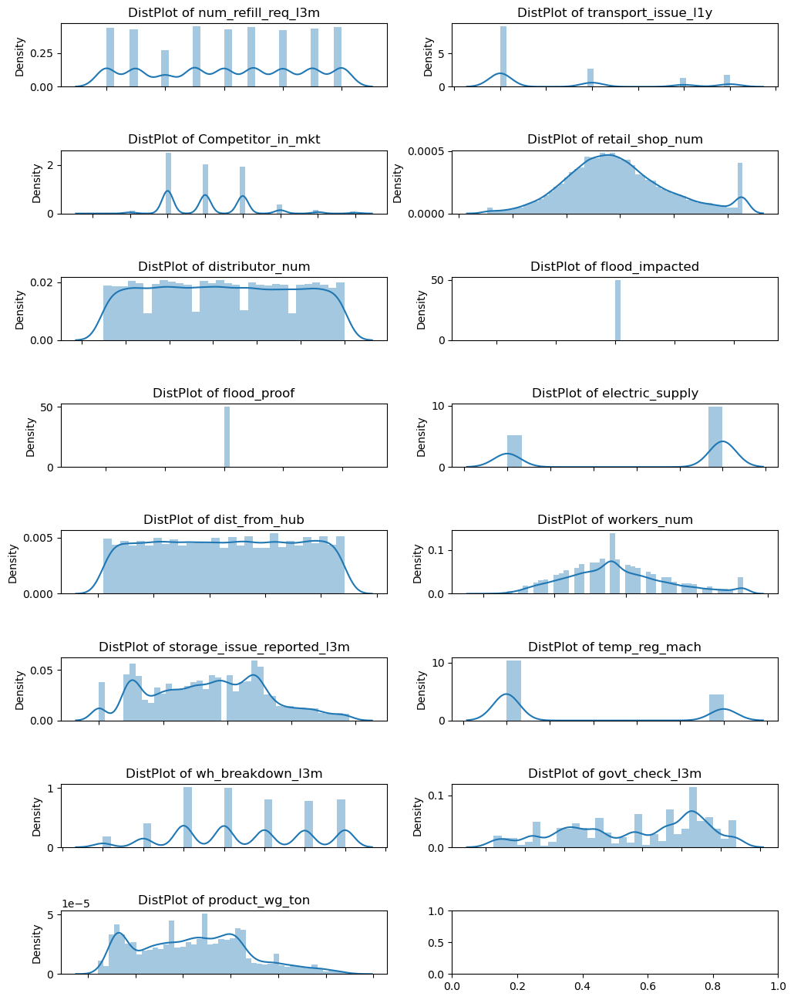

In [27]:
# Create a single large subplot to display all boxplots
fig, axes = plt.subplots(nrows=8, ncols=2, figsize=(12, 16))
fig.subplots_adjust(hspace=1)

# For loop to draw Seaborn boxplot graphs
for i, column in enumerate(columns_to_plot_numerical):
    row, col = divmod(i, 2)

    # Draw Seaborn boxplot graph
    sns.distplot(x=data[column], ax=axes[row, col])
    axes[row, col].set_title(f'DistPlot of {column}')
    axes[row, col].set_xticklabels([])  # Remove labels on x-axis
    axes[row, col].tick_params(axis='x', rotation=45)

plt.show()

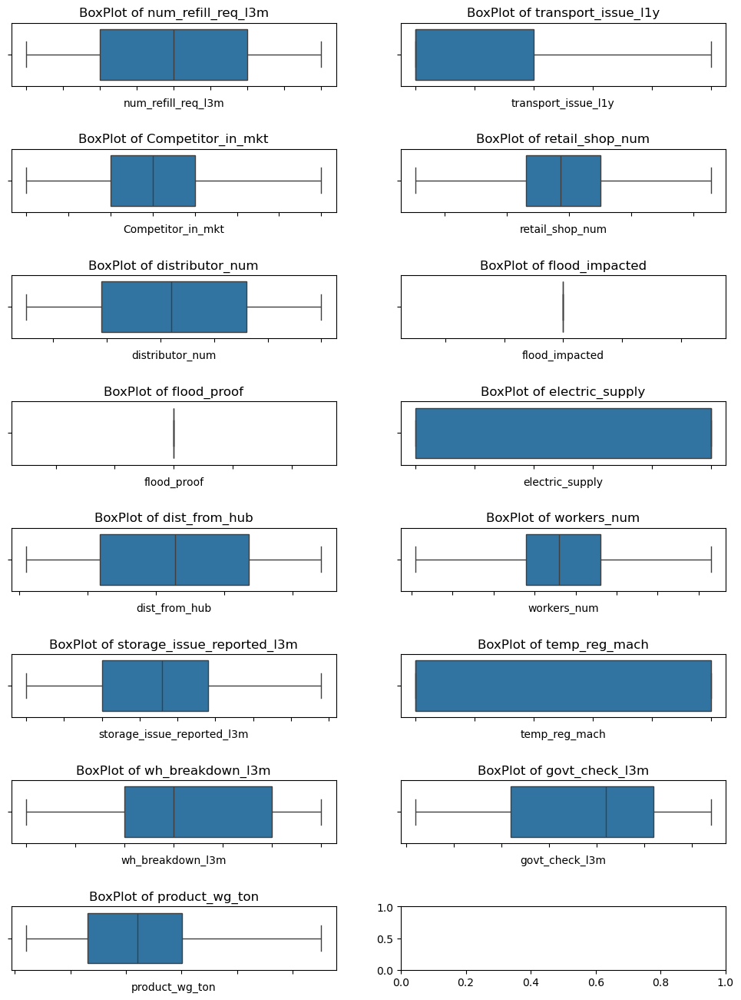

In [28]:
# Create a single large subplot to display all boxplots
fig, axes = plt.subplots(nrows=8, ncols=2, figsize=(12, 16))
fig.subplots_adjust(hspace=1)

# For loop to draw Seaborn boxplot graphs
for i, column in enumerate(columns_to_plot_numerical):
    row, col = divmod(i, 2)

    # Draw Seaborn boxplot graph
    sns.boxplot(x=data[column], ax=axes[row, col])
    axes[row, col].set_title(f'BoxPlot of {column}')
    axes[row, col].set_xticklabels([])  # Remove labels on x-axis
    axes[row, col].tick_params(axis='x', rotation=45)

plt.show()

In [29]:
data.nunique()

Location_type                      2
WH_capacity_size                   3
zone                               4
WH_regional_zone                   6
num_refill_req_l3m                 9
transport_issue_l1y                4
Competitor_in_mkt                  8
retail_shop_num                 4151
wh_owner_type                      2
distributor_num                   56
flood_impacted                     1
flood_proof                        1
electric_supply                    2
dist_from_hub                    217
workers_num                       38
storage_issue_reported_l3m        37
temp_reg_mach                      2
approved_wh_govt_certificate       5
wh_breakdown_l3m                   7
govt_check_l3m                    32
product_wg_ton                  4561
dtype: int64

In [30]:
data.drop(columns=['flood_impacted'], inplace = True)

##dropping column

In [31]:
data.drop(columns=['flood_proof'], inplace = True)

##dropping column

In [32]:
data.nunique()

Location_type                      2
WH_capacity_size                   3
zone                               4
WH_regional_zone                   6
num_refill_req_l3m                 9
transport_issue_l1y                4
Competitor_in_mkt                  8
retail_shop_num                 4151
wh_owner_type                      2
distributor_num                   56
electric_supply                    2
dist_from_hub                    217
workers_num                       38
storage_issue_reported_l3m        37
temp_reg_mach                      2
approved_wh_govt_certificate       5
wh_breakdown_l3m                   7
govt_check_l3m                    32
product_wg_ton                  4561
dtype: int64

In [33]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25000 entries, 0 to 24999
Data columns (total 19 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Location_type                 25000 non-null  object 
 1   WH_capacity_size              25000 non-null  object 
 2   zone                          25000 non-null  object 
 3   WH_regional_zone              25000 non-null  object 
 4   num_refill_req_l3m            25000 non-null  float64
 5   transport_issue_l1y           25000 non-null  float64
 6   Competitor_in_mkt             25000 non-null  float64
 7   retail_shop_num               25000 non-null  float64
 8   wh_owner_type                 25000 non-null  object 
 9   distributor_num               25000 non-null  float64
 10  electric_supply               25000 non-null  float64
 11  dist_from_hub                 25000 non-null  float64
 12  workers_num                   25000 non-null  float64
 13  s

**Univariate analysis**

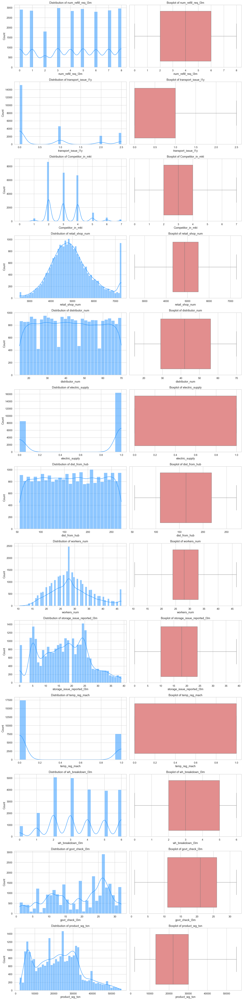

In [34]:

# Set plotting style
sns.set(style="whitegrid", palette="Set2", font_scale=1.1)

# Identify numeric columns
num_cols = data.select_dtypes(include=['int64', 'float64']).columns

# Plot histograms and boxplots
fig, axes = plt.subplots(nrows=len(num_cols), ncols=2, figsize=(16, 5*len(num_cols)))

for i, col in enumerate(num_cols):
    sns.histplot(data[col], kde=True, ax=axes[i, 0], color='dodgerblue')
    axes[i, 0].set_title(f'Distribution of {col}')
    
    sns.boxplot(x=data[col], ax=axes[i, 1], color='lightcoral')
    axes[i, 1].set_title(f'Boxplot of {col}')

plt.tight_layout()
plt.show()


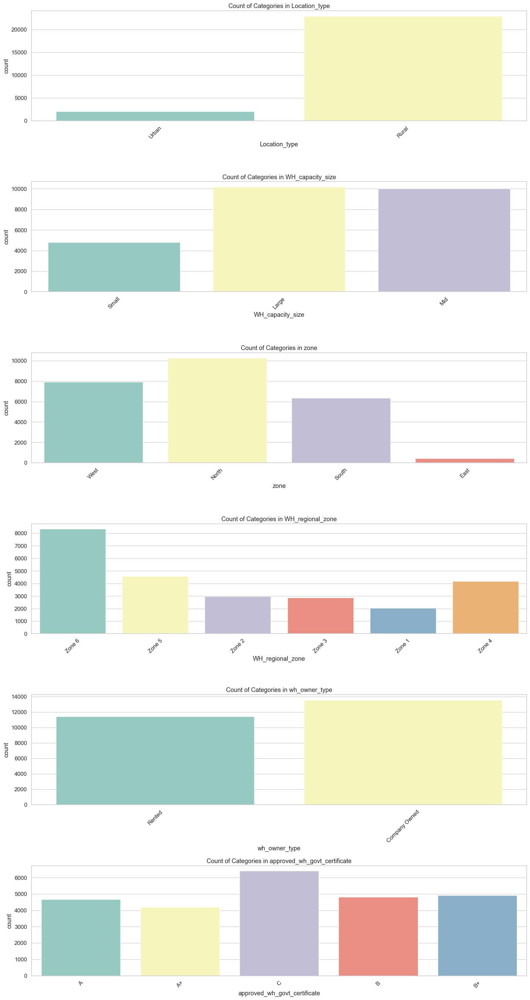

In [35]:
# Plot countplots for each categorical column
cat_cols = data.select_dtypes(include='object').columns

plt.figure(figsize=(16, 5 * len(cat_cols)))
for i, col in enumerate(cat_cols):
    plt.subplot(len(cat_cols), 1, i + 1)
    sns.countplot(data=data, x=col, palette='Set3')
    plt.title(f'Count of Categories in {col}')
    plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


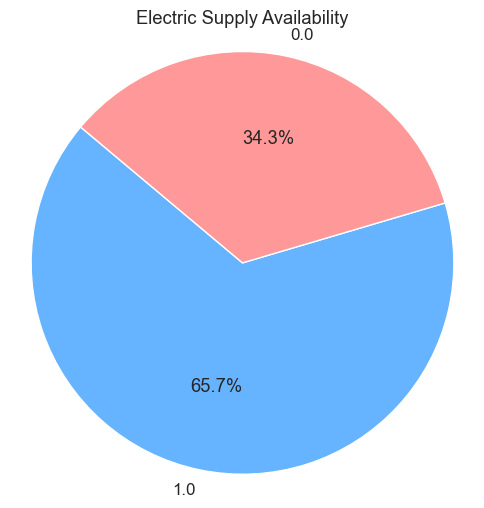

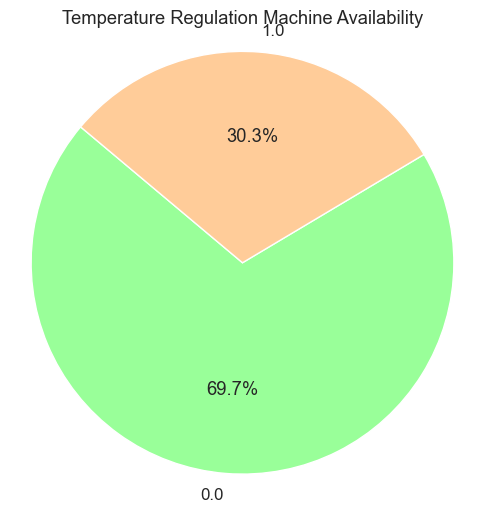

In [36]:

# Pie chart for Electric Supply
electric_counts = data['electric_supply'].value_counts()
plt.figure(figsize=(6, 6))
plt.pie(electric_counts, labels=electric_counts.index, autopct='%1.1f%%', startangle=140, colors=['#66b3ff','#ff9999'])
plt.title('Electric Supply Availability')
plt.axis('equal')  # Equal aspect ratio ensures the pie is circular
plt.show()

# Pie chart for Temperature Regulation Machine Availability
temp_mach_counts = data['temp_reg_mach'].value_counts()
plt.figure(figsize=(6, 6))
plt.pie(temp_mach_counts, labels=temp_mach_counts.index, autopct='%1.1f%%', startangle=140, colors=['#99ff99','#ffcc99'])
plt.title('Temperature Regulation Machine Availability')
plt.axis('equal')
plt.show()


**Bivariate analysis**

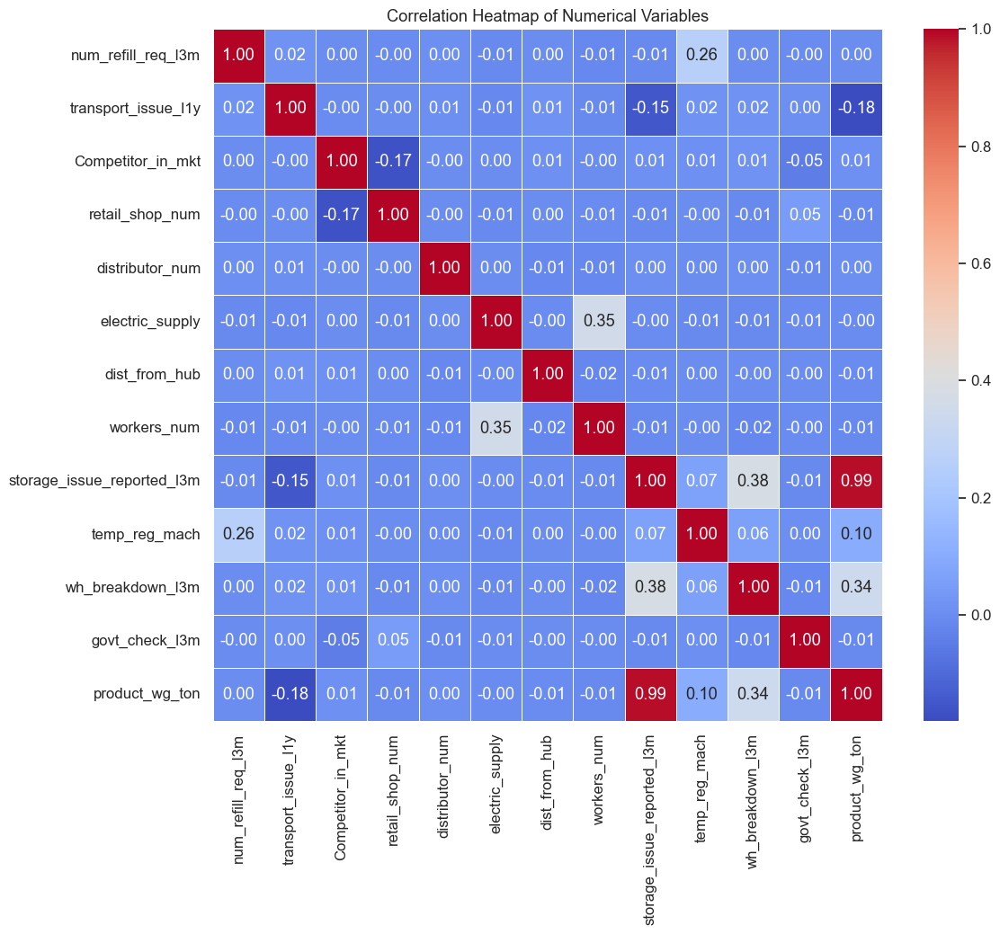

In [37]:


# Compute correlation matrix
corr_matrix = data.select_dtypes(include=['int64', 'float64']).corr()

# Plot heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Heatmap of Numerical Variables")
plt.show()


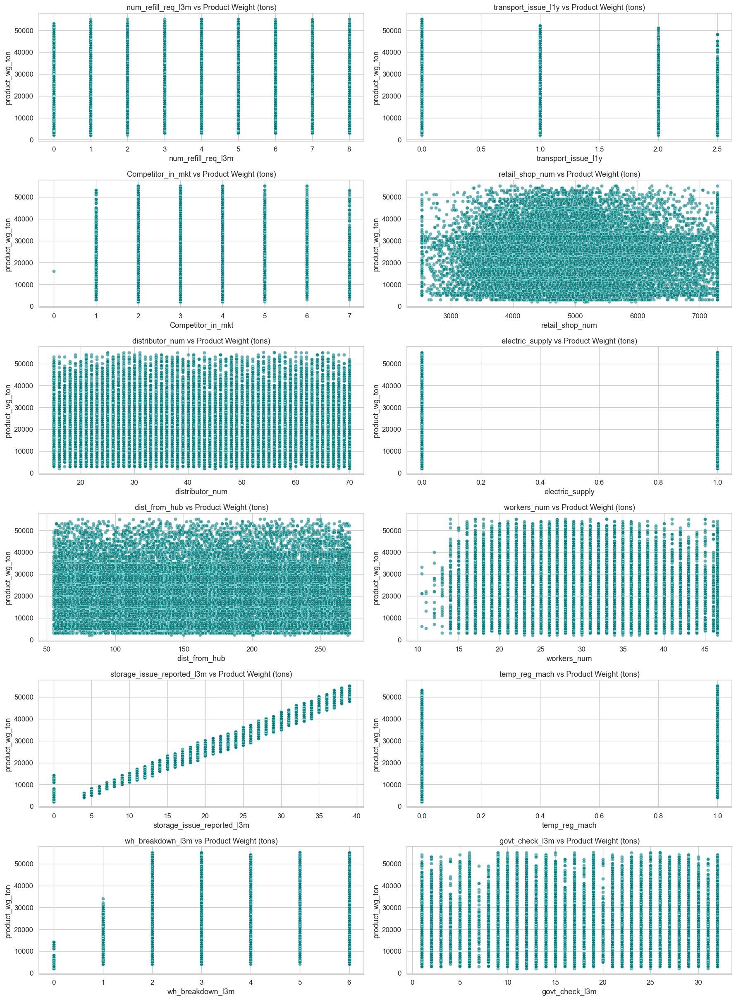

In [38]:
# Numerical columns excluding target
num_cols = [col for col in data.select_dtypes(include=['int64', 'float64']).columns if col != 'product_wg_ton']

# Plot scatter plots
plt.figure(figsize=(18, 4 * len(num_cols)))
for i, col in enumerate(num_cols):
    plt.subplot(len(num_cols), 2, i + 1)
    sns.scatterplot(x=data[col], y=data['product_wg_ton'], alpha=0.6, color='teal')
    plt.title(f'{col} vs Product Weight (tons)')

plt.tight_layout()
plt.show()


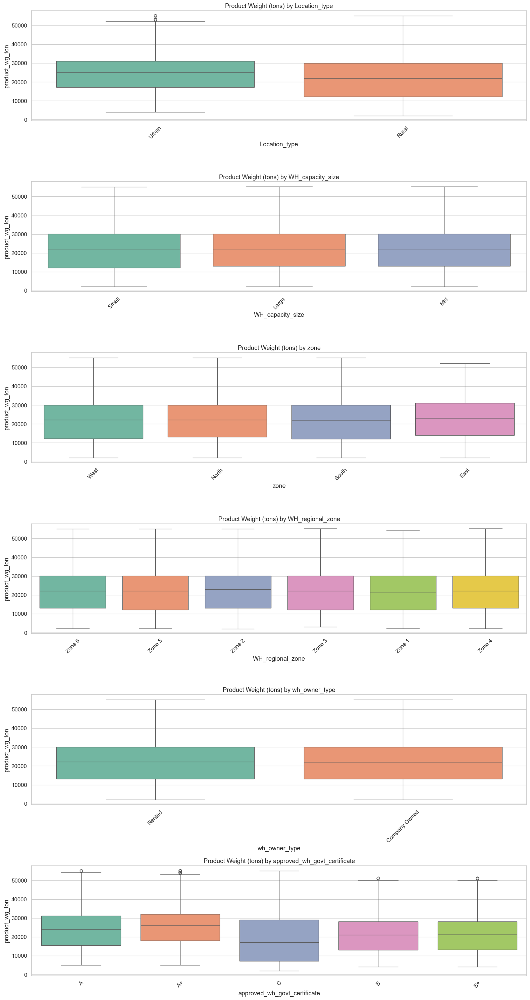

In [39]:
# Categorical columns
cat_cols = data.select_dtypes(include='object').columns

# Plot boxplots
plt.figure(figsize=(16, 5 * len(cat_cols)))
for i, col in enumerate(cat_cols):
    plt.subplot(len(cat_cols), 1, i + 1)
    sns.boxplot(data=data, x=col, y='product_wg_ton', palette='Set2')
    plt.title(f'Product Weight (tons) by {col}')
    plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


**Multivariate analysis**

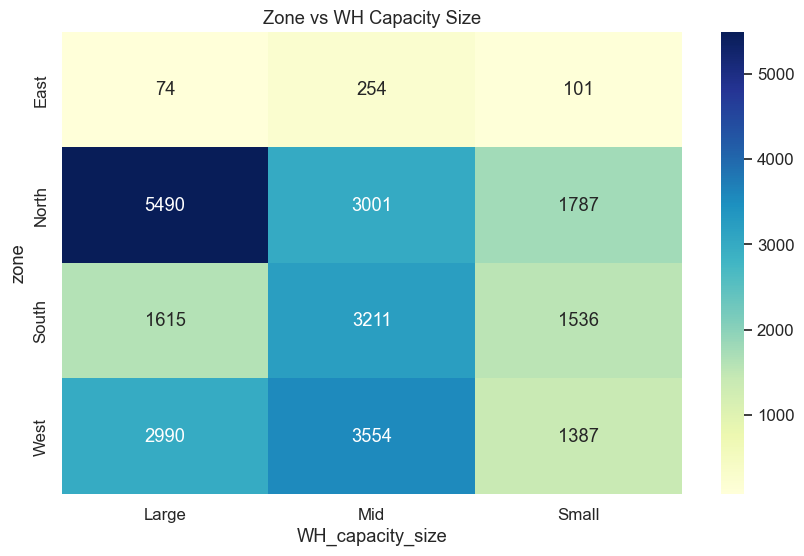

In [40]:
# Example: Cross-tab heatmap
cross_tab = pd.crosstab(data['zone'], data['WH_capacity_size'])

plt.figure(figsize=(10, 6))
sns.heatmap(cross_tab, annot=True, fmt='d', cmap='YlGnBu')
plt.title("Zone vs WH Capacity Size")
plt.show()


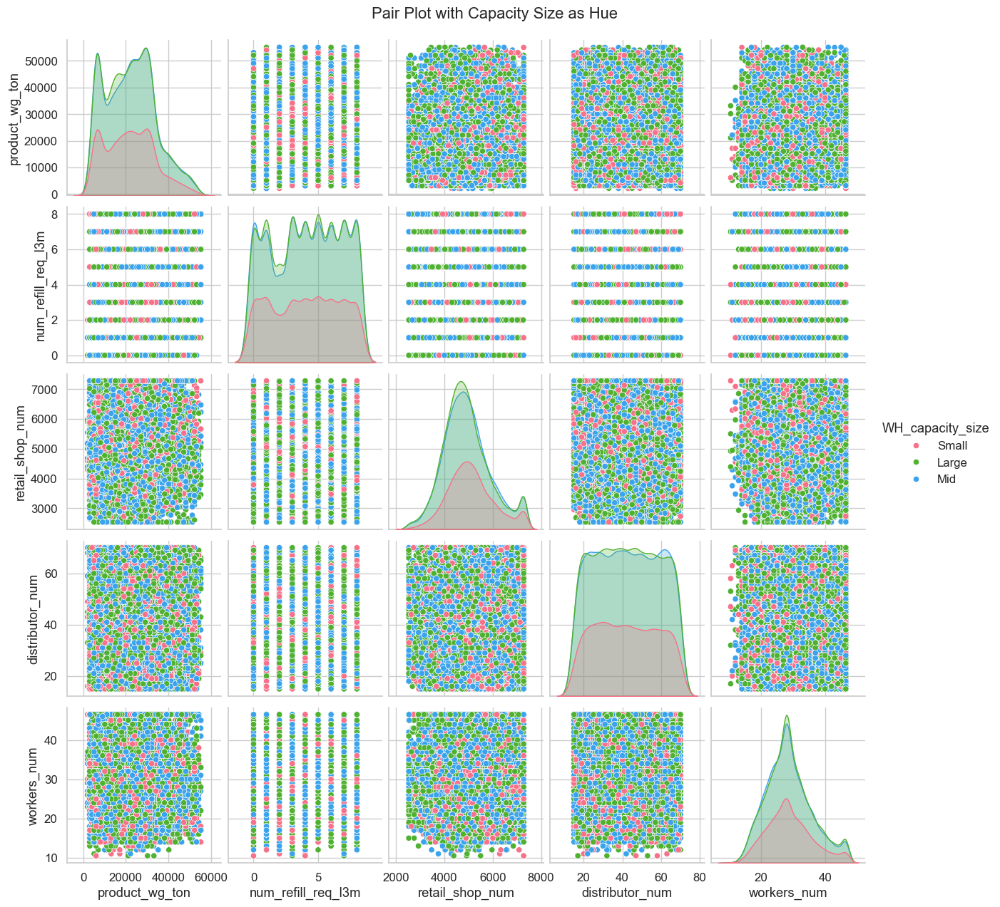

In [41]:


# Select a subset of numeric features and categorical hue
selected_features = [
    'product_wg_ton', 'num_refill_req_l3m', 'retail_shop_num', 
    'distributor_num', 'workers_num'
]

# Add a hue (e.g., warehouse capacity size)
sns.pairplot(data[selected_features + ['WH_capacity_size']], 
             hue='WH_capacity_size', palette='husl', diag_kind='kde')
plt.suptitle("Pair Plot with Capacity Size as Hue", y=1.02)
plt.show()


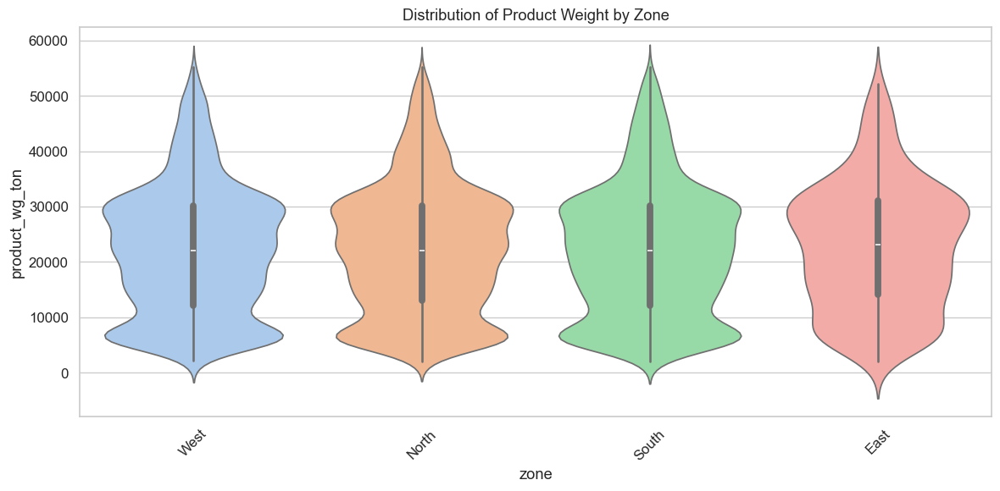

In [42]:
plt.figure(figsize=(12, 6))
sns.violinplot(data=data, x='zone', y='product_wg_ton', palette='pastel')
plt.title("Distribution of Product Weight by Zone")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


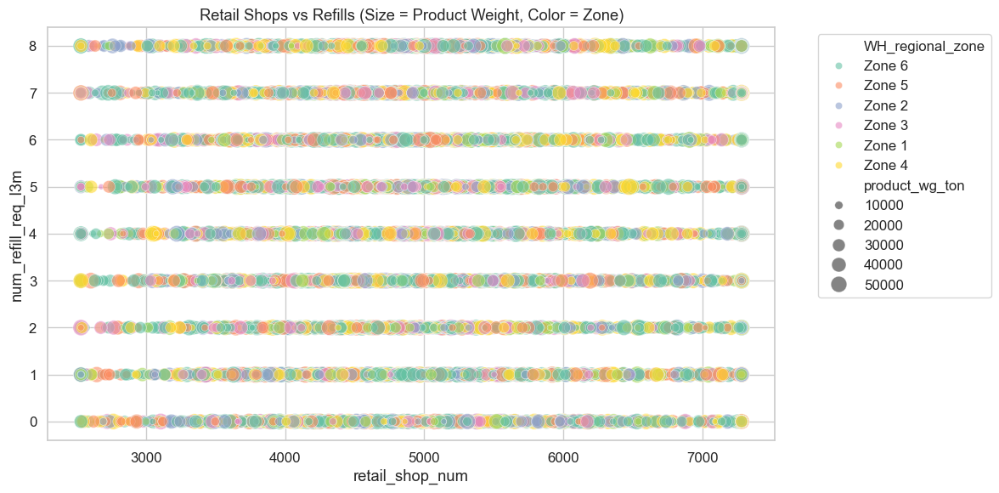

In [43]:
plt.figure(figsize=(12, 6))
sns.scatterplot(
    data=data,
    x='retail_shop_num', 
    y='num_refill_req_l3m', 
    size='product_wg_ton', 
    hue='WH_regional_zone', 
    sizes=(20, 200), 
    alpha=0.6
)
plt.title("Retail Shops vs Refills (Size = Product Weight, Color = Zone)")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


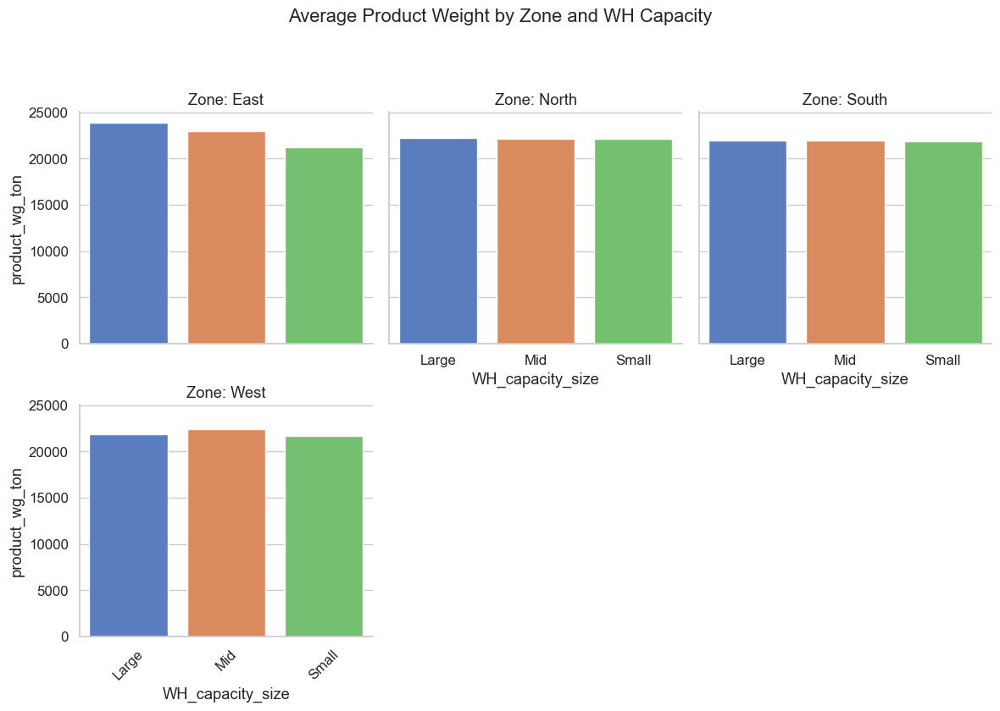

In [44]:
# Grouping to reduce noise
df_grouped = data.groupby(['zone', 'WH_capacity_size'])['product_wg_ton'].mean().reset_index()

# Facet grid
g = sns.FacetGrid(df_grouped, col="zone", col_wrap=3, height=4)
g.map_dataframe(sns.barplot, x="WH_capacity_size", y="product_wg_ton", palette="muted")
g.set_titles(col_template="Zone: {col_name}")
g.fig.suptitle("Average Product Weight by Zone and WH Capacity", y=1.05)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


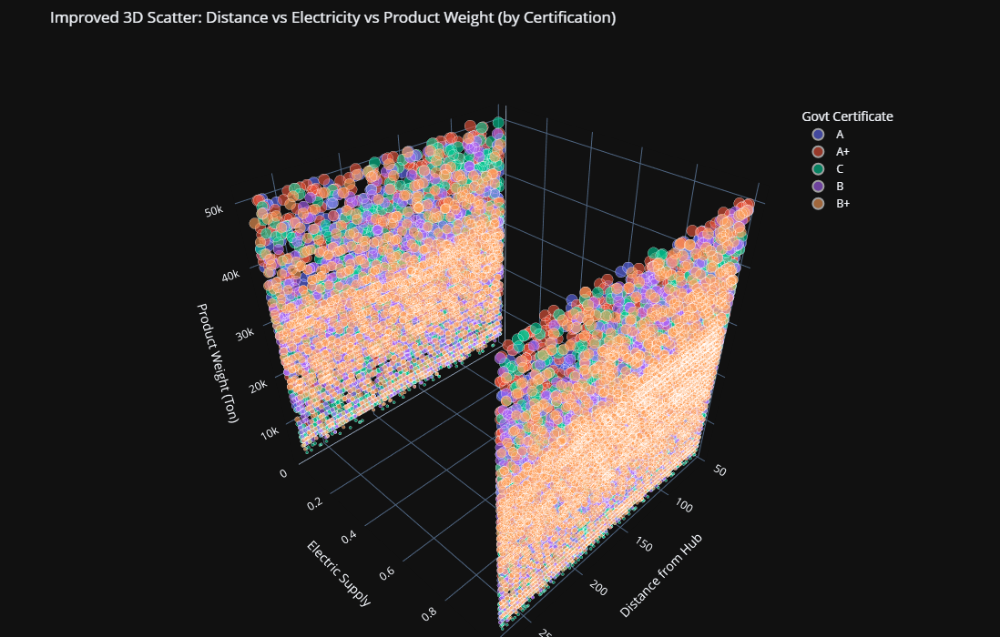

In [45]:
import plotly.express as px


# Preprocess: Drop missing and convert category
df_plot = data.dropna(subset=['dist_from_hub', 'electric_supply', 'product_wg_ton', 'approved_wh_govt_certificate']).copy()
df_plot['approved_wh_govt_certificate'] = df_plot['approved_wh_govt_certificate'].astype(str)

# Optional: Clip out extreme outliers in product weight
q_low = df_plot['product_wg_ton'].quantile(0.01)
q_high = df_plot['product_wg_ton'].quantile(0.99)
df_plot = df_plot[(df_plot['product_wg_ton'] >= q_low) & (df_plot['product_wg_ton'] <= q_high)]

# Make a larger and cleaner 3D scatter plot
fig = px.scatter_3d(
    df_plot,
    x='dist_from_hub',
    y='electric_supply',
    z='product_wg_ton',
    color='approved_wh_govt_certificate',
    size='product_wg_ton',
    opacity=0.6,
    title='Improved 3D Scatter: Distance vs Electricity vs Product Weight (by Certification)',
    template='plotly_dark'
)

fig.update_layout(
    width=1000,
    height=700,
    margin=dict(l=0, r=0, b=0, t=50),
    legend=dict(title='Govt Certificate', x=0.8, y=0.9),
    scene=dict(
        xaxis_title='Distance from Hub',
        yaxis_title='Electric Supply',
        zaxis_title='Product Weight (Ton)',
    )
)

fig.show()


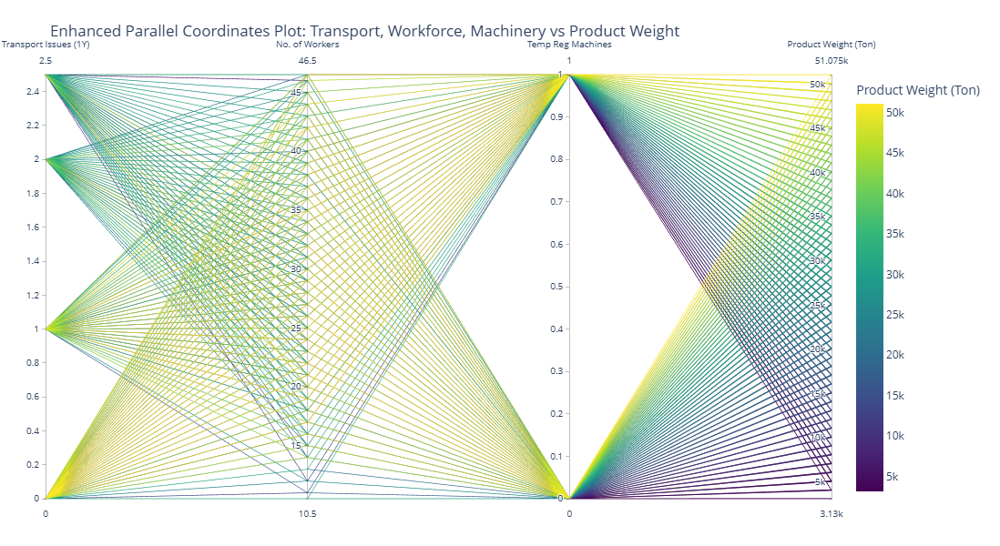

In [46]:
# Subset & drop missing values
df_parallel = data[['product_wg_ton', 'transport_issue_l1y', 'workers_num', 'temp_reg_mach', 'Location_type']].dropna()
df_parallel['Location_type'] = df_parallel['Location_type'].astype(str)

# Optional: Cap outliers in product_wg_ton for smoother visualization
q1 = df_parallel['product_wg_ton'].quantile(0.01)
q99 = df_parallel['product_wg_ton'].quantile(0.99)
df_parallel = df_parallel[(df_parallel['product_wg_ton'] >= q1) & (df_parallel['product_wg_ton'] <= q99)]

# Plot
fig = px.parallel_coordinates(
    df_parallel,
    dimensions=['transport_issue_l1y', 'workers_num', 'temp_reg_mach', 'product_wg_ton'],
    color='product_wg_ton',
    color_continuous_scale='Viridis',
    labels={
        'transport_issue_l1y': 'Transport Issues (1Y)',
        'workers_num': 'No. of Workers',
        'temp_reg_mach': 'Temp Reg Machines',
        'product_wg_ton': 'Product Weight (Ton)'
    },
    title='Enhanced Parallel Coordinates Plot: Transport, Workforce, Machinery vs Product Weight'
)


fig.update_layout(
    width=1100,
    height=600,
    margin=dict(l=50, r=50, t=80, b=50),
    font=dict(size=12)
)

fig.show()


**Model building and interpretation**

In [47]:
data.head()

,Location_type,WH_capacity_size,zone,WH_regional_zone,num_refill_req_l3m,transport_issue_l1y,Competitor_in_mkt,retail_shop_num,wh_owner_type,distributor_num,electric_supply,dist_from_hub,workers_num,storage_issue_reported_l3m,temp_reg_mach,approved_wh_govt_certificate,wh_breakdown_l3m,govt_check_l3m,product_wg_ton
0,Urban,Small,West,Zone 6,3.0,1.0,2.0,4651.0,Rented,24.0,1.0,91.0,29.0,13.0,0.0,A,5.0,15.0,17115.0
1,Rural,Large,North,Zone 5,0.0,0.0,4.0,6217.0,Company Owned,47.0,1.0,210.0,31.0,4.0,0.0,A,3.0,17.0,5074.0
2,Rural,Mid,South,Zone 2,1.0,0.0,4.0,4306.0,Company Owned,64.0,0.0,161.0,37.0,17.0,0.0,A,6.0,22.0,23137.0
3,Rural,Mid,North,Zone 3,7.0,2.5,2.0,6000.0,Rented,50.0,0.0,103.0,21.0,17.0,1.0,A+,3.0,27.0,22115.0
4,Rural,Large,North,Zone 5,3.0,1.0,2.0,4740.0,Company Owned,42.0,1.0,112.0,25.0,18.0,0.0,C,6.0,24.0,24071.0


In [48]:
# display number of unique values in each column
data.nunique().sort_values(ascending=False)

product_wg_ton                  4561
retail_shop_num                 4151
dist_from_hub                    217
distributor_num                   56
workers_num                       38
storage_issue_reported_l3m        37
govt_check_l3m                    32
num_refill_req_l3m                 9
Competitor_in_mkt                  8
wh_breakdown_l3m                   7
WH_regional_zone                   6
approved_wh_govt_certificate       5
transport_issue_l1y                4
zone                               4
WH_capacity_size                   3
wh_owner_type                      2
electric_supply                    2
temp_reg_mach                      2
Location_type                      2
dtype: int64

In [49]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25000 entries, 0 to 24999
Data columns (total 19 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Location_type                 25000 non-null  object 
 1   WH_capacity_size              25000 non-null  object 
 2   zone                          25000 non-null  object 
 3   WH_regional_zone              25000 non-null  object 
 4   num_refill_req_l3m            25000 non-null  float64
 5   transport_issue_l1y           25000 non-null  float64
 6   Competitor_in_mkt             25000 non-null  float64
 7   retail_shop_num               25000 non-null  float64
 8   wh_owner_type                 25000 non-null  object 
 9   distributor_num               25000 non-null  float64
 10  electric_supply               25000 non-null  float64
 11  dist_from_hub                 25000 non-null  float64
 12  workers_num                   25000 non-null  float64
 13  s

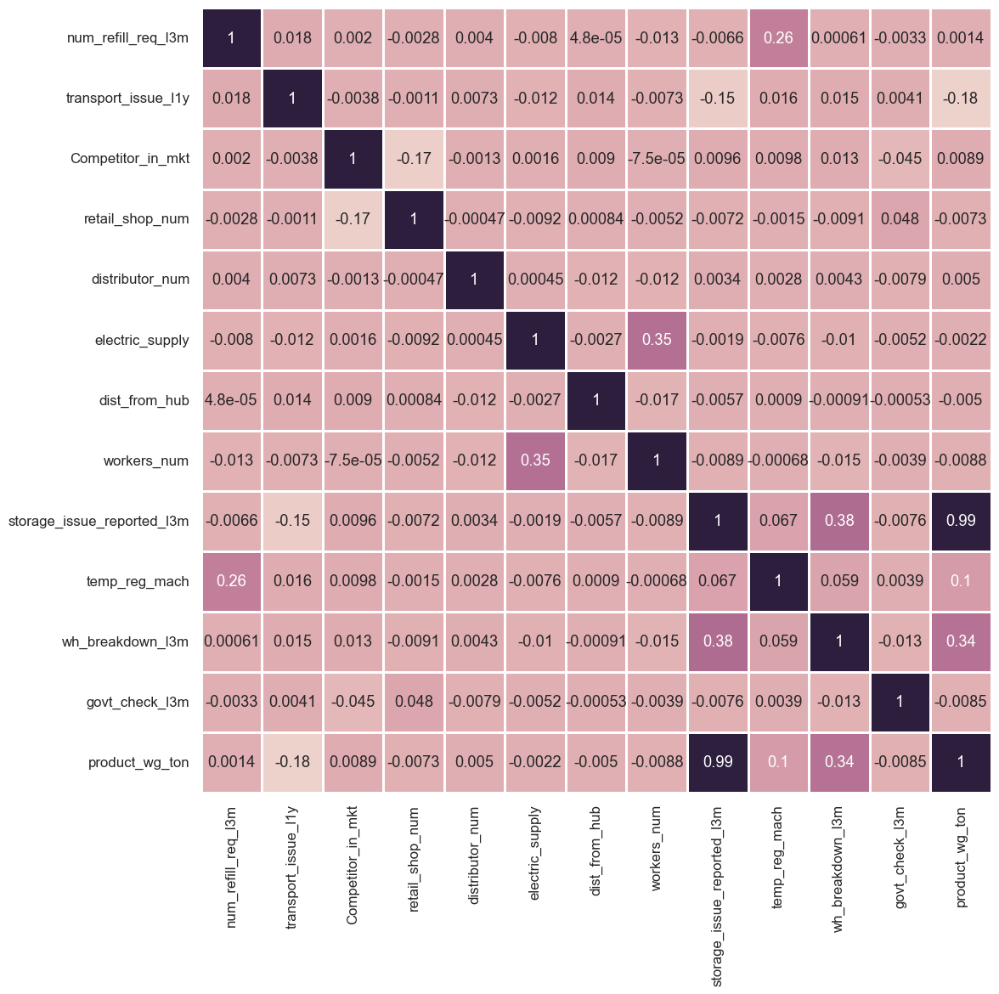

In [50]:
plt.figure(figsize=(12, 12))
corr = data.corr(numeric_only=True)
sns.heatmap(corr, annot=True, cmap=sns.cubehelix_palette(as_cmap=True), linewidths=1, cbar=False)
plt.show()

**Encoding -**

*Following variables can be encoded using one-hot encoding as they do not have any ordinal nature:*





*Location_type*

*zone*

*WH_regional_zone*

*wh_owner_type*

In [51]:
data=pd.get_dummies(data, columns=['Location_type', 'zone', 'WH_regional_zone', 'wh_owner_type'],drop_first=True)

*Following variables can be encoded using label encoding as they have ordinal nature:*

*WH_capacity_size*

*approved_wh_govt_certificate*

In [52]:
def label_encoding(column):
    label_encoder = preprocessing.LabelEncoder()
    data[column] = label_encoder.fit_transform(data[column])
    
for col in ['WH_capacity_size', 'approved_wh_govt_certificate']:
    label_encoding(col)

In [53]:
check_data(data)
data.head()

Number of data points :  25000
Number of features/columns :  25 
 ----------------------------------------------------------------------------------------------------
Features :  ['WH_capacity_size' 'num_refill_req_l3m' 'transport_issue_l1y'
 'Competitor_in_mkt' 'retail_shop_num' 'distributor_num' 'electric_supply'
 'dist_from_hub' 'workers_num' 'storage_issue_reported_l3m'
 'temp_reg_mach' 'approved_wh_govt_certificate' 'wh_breakdown_l3m'
 'govt_check_l3m' 'product_wg_ton' 'Location_type_Urban' 'zone_North'
 'zone_South' 'zone_West' 'WH_regional_zone_Zone 2'
 'WH_regional_zone_Zone 3' 'WH_regional_zone_Zone 4'
 'WH_regional_zone_Zone 5' 'WH_regional_zone_Zone 6'
 'wh_owner_type_Rented']


,WH_capacity_size,num_refill_req_l3m,transport_issue_l1y,Competitor_in_mkt,retail_shop_num,distributor_num,electric_supply,dist_from_hub,workers_num,storage_issue_reported_l3m,...,Location_type_Urban,zone_North,zone_South,zone_West,WH_regional_zone_Zone 2,WH_regional_zone_Zone 3,WH_regional_zone_Zone 4,WH_regional_zone_Zone 5,WH_regional_zone_Zone 6,wh_owner_type_Rented
0,2,3.0,1.0,2.0,4651.0,24.0,1.0,91.0,29.0,13.0,...,True,False,False,True,False,False,False,False,True,True
1,0,0.0,0.0,4.0,6217.0,47.0,1.0,210.0,31.0,4.0,...,False,True,False,False,False,False,False,True,False,False
2,1,1.0,0.0,4.0,4306.0,64.0,0.0,161.0,37.0,17.0,...,False,False,True,False,True,False,False,False,False,False
3,1,7.0,2.5,2.0,6000.0,50.0,0.0,103.0,21.0,17.0,...,False,True,False,False,False,True,False,False,False,True
4,0,3.0,1.0,2.0,4740.0,42.0,1.0,112.0,25.0,18.0,...,False,True,False,False,False,False,False,True,False,False


In [54]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25000 entries, 0 to 24999
Data columns (total 25 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   WH_capacity_size              25000 non-null  int32  
 1   num_refill_req_l3m            25000 non-null  float64
 2   transport_issue_l1y           25000 non-null  float64
 3   Competitor_in_mkt             25000 non-null  float64
 4   retail_shop_num               25000 non-null  float64
 5   distributor_num               25000 non-null  float64
 6   electric_supply               25000 non-null  float64
 7   dist_from_hub                 25000 non-null  float64
 8   workers_num                   25000 non-null  float64
 9   storage_issue_reported_l3m    25000 non-null  float64
 10  temp_reg_mach                 25000 non-null  float64
 11  approved_wh_govt_certificate  25000 non-null  int32  
 12  wh_breakdown_l3m              25000 non-null  float64
 13  g

**Train-Test Split**

*Remove the dependent variable from the feature dataframe*

In [55]:
X = data.drop(['product_wg_ton'], axis=1)
y = data['product_wg_ton']

In [56]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=42)
print("Dimension of X_train:", X_train.shape)
print("Dimension of X_test:", X_test.shape)

Dimension of X_train: (20000, 24)
Dimension of X_test: (5000, 24)


*Standardization of dataset*

In [57]:
non_categorical_columns = [   
    'num_refill_req_l3m',
    'transport_issue_l1y',
    'Competitor_in_mkt',
    'retail_shop_num',
    'distributor_num',
    'electric_supply',
    'dist_from_hub',
    'workers_num',
    'storage_issue_reported_l3m',
    'temp_reg_mach',
    'wh_breakdown_l3m',
    'govt_check_l3m']

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=42)

scaler = StandardScaler()
X_train[non_categorical_columns] = scaler.fit_transform(X_train[non_categorical_columns])

# using same fit params of train data for the test data to avoid data leakage
X_test[non_categorical_columns] = scaler.transform(X_test[non_categorical_columns])

X_train.head()

,WH_capacity_size,num_refill_req_l3m,transport_issue_l1y,Competitor_in_mkt,retail_shop_num,distributor_num,electric_supply,dist_from_hub,workers_num,storage_issue_reported_l3m,...,Location_type_Urban,zone_North,zone_South,zone_West,WH_regional_zone_Zone 2,WH_regional_zone_Zone 3,WH_regional_zone_Zone 4,WH_regional_zone_Zone 5,WH_regional_zone_Zone 6,wh_owner_type_Rented
23311,0,-1.188838,0.372996,0.815374,-0.908895,1.033787,0.719661,1.193945,-0.949013,1.184447,...,False,False,False,True,False,False,False,False,True,False
23623,1,1.496848,-0.715249,-0.083555,1.155974,0.659390,0.719661,0.954705,0.171874,2.165712,...,False,True,False,False,False,True,False,False,False,True
1020,0,1.496848,-0.715249,0.815374,-0.891326,0.284994,0.719661,-0.018206,-0.388570,0.748329,...,False,True,False,False,False,False,False,False,True,False
12645,0,1.496848,0.372996,-0.982485,-0.517210,0.596991,0.719661,-0.624282,1.572983,0.966388,...,False,False,True,False,False,False,False,True,False,False
1533,0,-0.037830,-0.715249,0.815374,-0.145162,0.596991,-1.389544,-0.177700,-1.509457,0.203182,...,False,True,False,False,False,False,False,False,True,True


**Building different ML Models**

In [58]:
from sklearn import metrics
import matplotlib.pyplot as plt
import numpy as np

def create_and_evaluate_model(model, X_train, y_train, X_test, y_test):
    model.fit(X_train, y_train)
    pred = model.predict(X_test)

    mae = metrics.mean_absolute_error(y_test, pred)
    mse = metrics.mean_squared_error(y_test, pred)
    r2 = metrics.r2_score(y_test, pred)

    # MAPE calculation with safe division
    mape = np.mean(np.abs((y_test - pred) / np.clip(np.abs(y_test), a_min=1e-8, a_max=None))) * 100

    print(model, ' MAE:', mae)
    print('--' * 50)
    print(model, ' MSE:', mse)
    print('--' * 50)
    print(model, ' R-Squared:', r2)
    print('--' * 50)
    print(model, ' MAPE:', mape, '%')
    print('=' * 50)

    plt.figure(figsize=(6, 4))
    plt.scatter(y_test, pred, alpha=0.5, edgecolor='k')
    plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'k--', label='Perfect Fit')
    plt.xlabel('Actual Values')
    plt.ylabel('Predicted Values')
    plt.title(f'{model.__class__.__name__}: Actual vs Predicted')
    plt.legend()
    plt.grid(True)
    plt.show()


In [59]:
LRmodel = LinearRegression()


In [60]:
LRmodel.fit(X_train, y_train)


LinearRegression()

In [61]:
LR_predicted = LRmodel.predict(X_test)

LinearRegression()  MAE: 1303.975230024751
----------------------------------------------------------------------------------------------------
LinearRegression()  MSE: 3093785.290088712
----------------------------------------------------------------------------------------------------
LinearRegression()  R-Squared: 0.9768775144228907
----------------------------------------------------------------------------------------------------
LinearRegression()  MAPE: 9.066061258054349 %


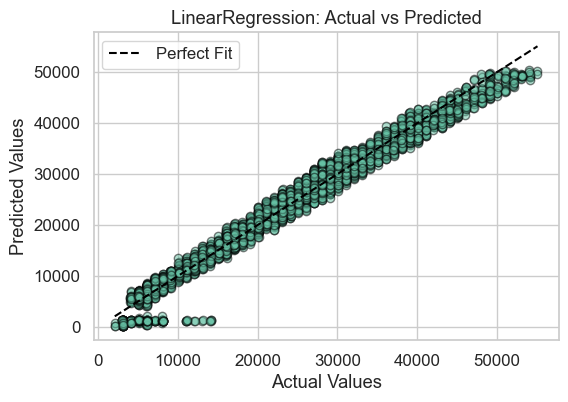

In [62]:
#Linear Regression Model


create_and_evaluate_model(LinearRegression(), X_train, y_train, X_test, y_test)

In [63]:
Rmodel = Ridge()

In [64]:
Rmodel.fit(X_train, y_train)

Ridge()

In [65]:
R_predicted = Rmodel.predict(X_test)

Ridge()  MAE: 1304.0128580377925
----------------------------------------------------------------------------------------------------
Ridge()  MSE: 3093803.4821990477
----------------------------------------------------------------------------------------------------
Ridge()  R-Squared: 0.9768773784577963
----------------------------------------------------------------------------------------------------
Ridge()  MAPE: 9.066456968454291 %


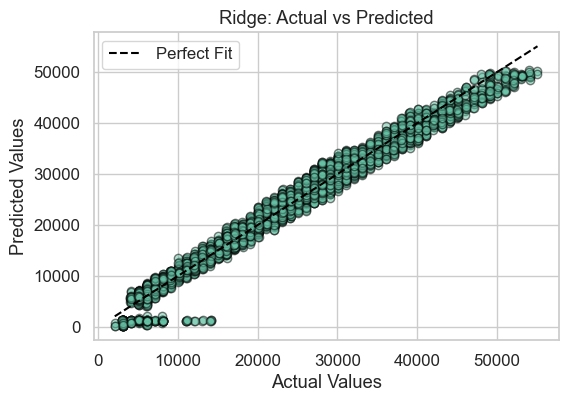

In [66]:
#Ridge Regression


create_and_evaluate_model(Ridge(), X_train, y_train, X_test, y_test)

In [67]:
from sklearn.tree import DecisionTreeRegressor

DTmodel = DecisionTreeRegressor()

In [68]:
DTmodel.fit(X_train, y_train)

DecisionTreeRegressor()

In [69]:
DT_predicted = DTmodel.predict(X_test)

DecisionTreeRegressor(random_state=42)  MAE: 869.624
----------------------------------------------------------------------------------------------------
DecisionTreeRegressor(random_state=42)  MSE: 1739755.8348
----------------------------------------------------------------------------------------------------
DecisionTreeRegressor(random_state=42)  R-Squared: 0.9869973267612565
----------------------------------------------------------------------------------------------------
DecisionTreeRegressor(random_state=42)  MAPE: 5.746088463148795 %


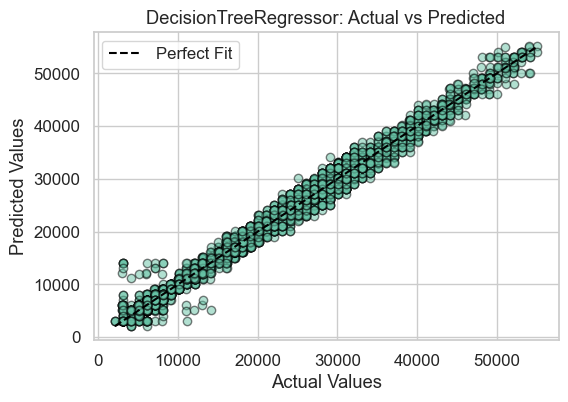

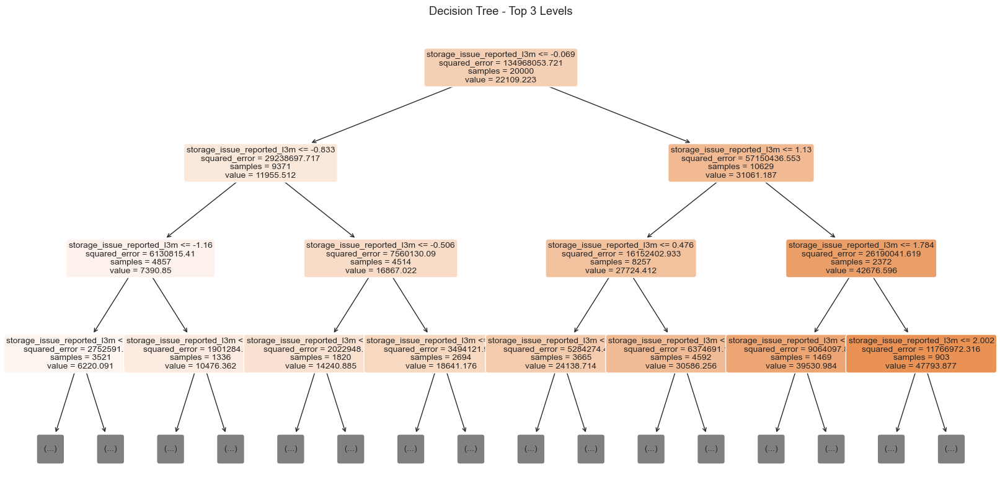

In [70]:

#Decision Tree

from sklearn.tree import DecisionTreeRegressor, plot_tree
import matplotlib.pyplot as plt

# Train the model
dt_model = DecisionTreeRegressor(random_state=42)
dt_model.fit(X_train, y_train)

# Evaluate the model
create_and_evaluate_model(dt_model, X_train, y_train, X_test, y_test)

# Plot the tree
plt.figure(figsize=(20, 10))  # Control figure size
plot_tree(dt_model, 
          feature_names=X_train.columns, 
          filled=True, 
          rounded=True, 
          max_depth=3,    # Show only top 3 levels for clarity
          fontsize=10)
plt.title("Decision Tree - Top 3 Levels")
plt.show()


In [71]:
Smodel = SVR()

In [72]:
Smodel.fit(X_train, y_train)

SVR()

In [73]:
S_predicted = Smodel.predict(X_test)

SVR()  MAE: 9201.023627557543
----------------------------------------------------------------------------------------------------
SVR()  MSE: 124884627.78575395
----------------------------------------------------------------------------------------------------
SVR()  R-Squared: 0.06663108974315357
----------------------------------------------------------------------------------------------------
SVR()  MAPE: 75.5950624510881 %


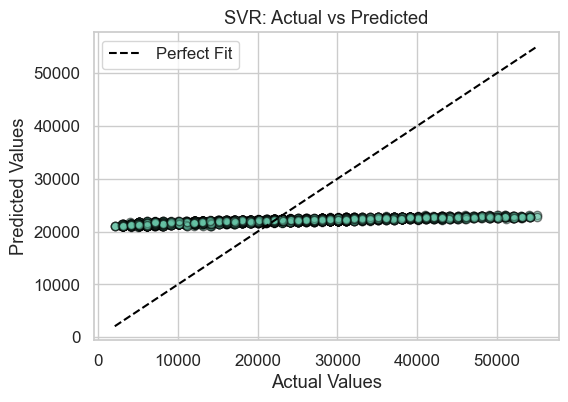

In [74]:
#SVR

create_and_evaluate_model(SVR(), X_train, y_train, X_test, y_test)

In [75]:
RFmodel = RandomForestRegressor()

In [76]:
RFmodel.fit(X_train, y_train)

RandomForestRegressor()

In [77]:
RF_predicted = RFmodel.predict(X_test)

RandomForestRegressor(random_state=42)  MAE: 697.7715919999999
----------------------------------------------------------------------------------------------------
RandomForestRegressor(random_state=42)  MSE: 872040.2121872
----------------------------------------------------------------------------------------------------
RandomForestRegressor(random_state=42)  R-Squared: 0.9934825027148605
----------------------------------------------------------------------------------------------------
RandomForestRegressor(random_state=42)  MAPE: 4.566165718471884 %


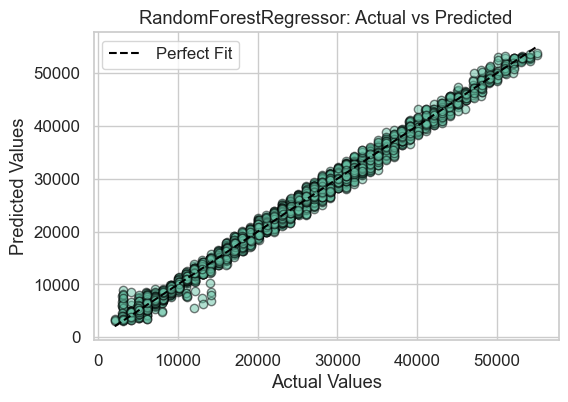

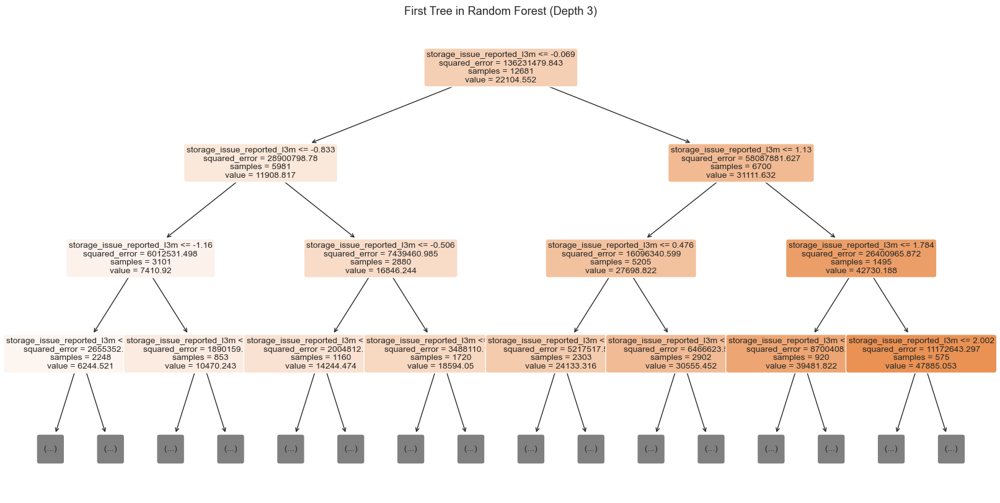

In [78]:
#Random Forest
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Train and evaluate the Random Forest model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
create_and_evaluate_model(rf_model, X_train, y_train, X_test, y_test)
rf_model.fit(X_train, y_train)

# Visualize the first decision tree in the forest
plt.figure(figsize=(20, 10))
plot_tree(rf_model.estimators_[0],  # First tree in the ensemble
          feature_names=X_train.columns,
          filled=True,
          rounded=True,
          max_depth=3,     # Adjust depth to avoid clutter
          fontsize=10)
plt.title("First Tree in Random Forest (Depth 3)")
plt.show()


In [79]:
from sklearn.ensemble import GradientBoostingRegressor
GBmodel = GradientBoostingRegressor()

In [80]:
GBmodel.fit(X_train,y_train)

GradientBoostingRegressor()

In [81]:
GB_predicted = GBmodel.predict(X_test)

GradientBoostingRegressor()  MAE: 689.4401832979133
----------------------------------------------------------------------------------------------------
GradientBoostingRegressor()  MSE: 836425.3304306809
----------------------------------------------------------------------------------------------------
GradientBoostingRegressor()  R-Squared: 0.9937486829803054
----------------------------------------------------------------------------------------------------
GradientBoostingRegressor()  MAPE: 4.606696592125074 %


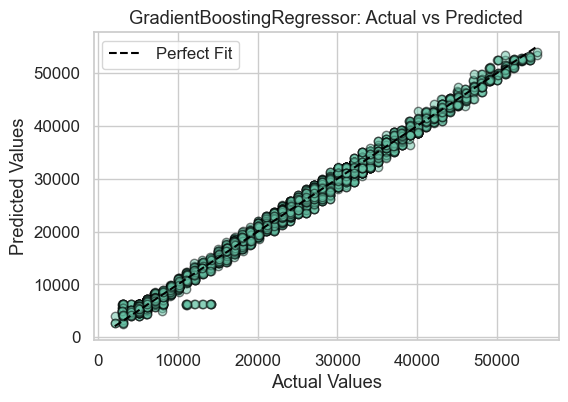

In [82]:
#Gradient Boosting

create_and_evaluate_model(GradientBoostingRegressor(), X_train, y_train, X_test, y_test)

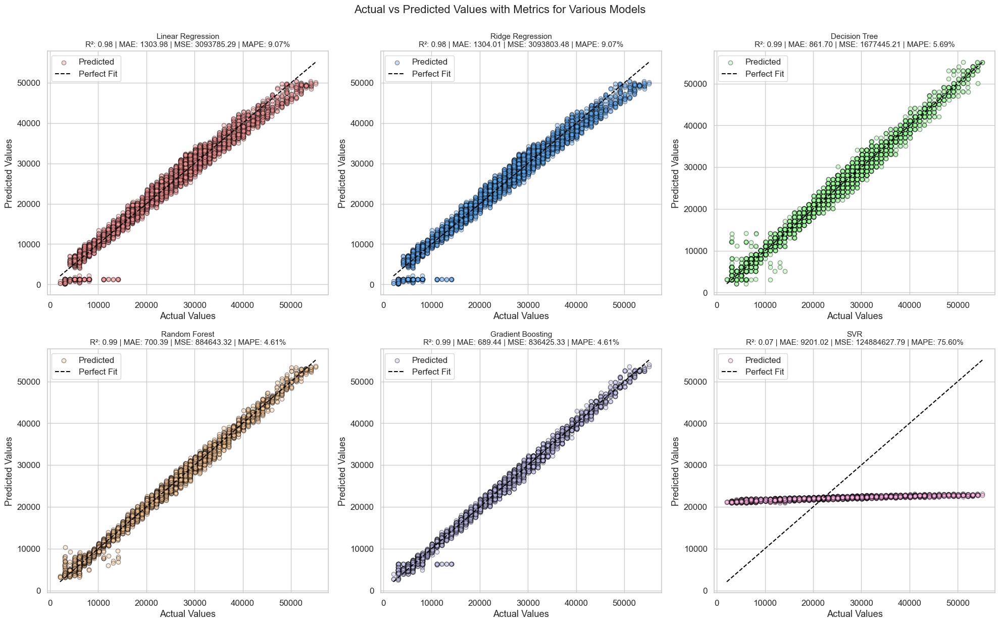

In [83]:

# Function to calculate R², MAE, MSE, and MAPE
def model_metrics(y_true, y_pred):
    r2 = metrics.r2_score(y_true, y_pred)
    mae = metrics.mean_absolute_error(y_true, y_pred)
    mse = metrics.mean_squared_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / np.clip(np.abs(y_true), a_min=1e-8, a_max=None))) * 100
    return r2, mae, mse, mape

# Store predictions and labels
predictions = {
    'Linear Regression': LR_predicted,
    'Ridge Regression': R_predicted,
    'Decision Tree': DT_predicted,
    'Random Forest': RF_predicted,
    'Gradient Boosting': GB_predicted,
    'SVR': S_predicted
}

colors = ['#ff9999', '#66b3ff', '#99ff99', '#ffcc99', '#c2c2f0', '#ffb3e6']

# Plotting
plt.figure(figsize=(20, 12))

for i, (model_name, pred_values) in enumerate(predictions.items()):
    r2, mae, mse, mape = model_metrics(y_test, pred_values) 
    
    ax = plt.subplot2grid((2, 3), (i // 3, i % 3))
    ax.scatter(y_test, pred_values, color=colors[i], alpha=0.4, edgecolor='k', label='Predicted')
    ax.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], '--', color='black', label='Perfect Fit')
    
    ax.set_title(
        f"{model_name}\nR²: {r2:.2f} | MAE: {mae:.2f} | MSE: {mse:.2f} | MAPE: {mape:.2f}%", 
        fontsize=11
    )
    ax.set_xlabel('Actual Values')
    ax.set_ylabel('Predicted Values')
    ax.legend()

plt.tight_layout()
plt.suptitle('Actual vs Predicted Values with Metrics for Various Models', fontsize=16, y=1.03)
plt.show()


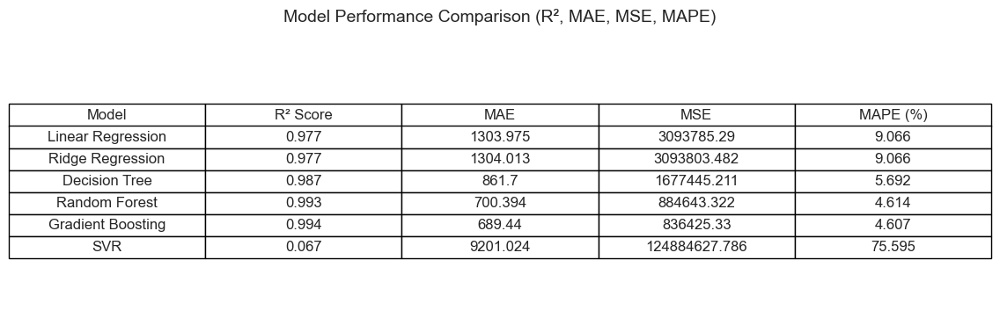

In [84]:

# List of model names and their predictions
model_names = ['Linear Regression', 'Ridge Regression', 'Decision Tree', 'Random Forest', 'Gradient Boosting', 'SVR']
model_preds = [LR_predicted, R_predicted, DT_predicted, RF_predicted, GB_predicted, S_predicted]

# Collect evaluation metrics
results = []
for name, pred in zip(model_names, model_preds):
    r2 = metrics.r2_score(y_test, pred)
    mae = metrics.mean_absolute_error(y_test, pred)
    mse = metrics.mean_squared_error(y_test, pred)
    mape = np.mean(np.abs((y_test - pred) / np.clip(np.abs(y_test), a_min=1e-8, a_max=None))) * 100
    results.append({'Model': name, 'R² Score': r2, 'MAE': mae, 'MSE': mse, 'MAPE (%)': mape})

# Convert to DataFrame
results_df = pd.DataFrame(results)

# Round values for cleaner display
results_df = results_df.round(3)

# Display as a table plot
fig, ax = plt.subplots(figsize=(12, 4))
ax.axis('off')
table = ax.table(cellText=results_df.values,
                 colLabels=results_df.columns,
                 cellLoc='center',
                 loc='center')

table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.2, 1.5)

plt.title("Model Performance Comparison (R², MAE, MSE, MAPE)", fontsize=14, pad=20)
plt.show()


**Hyperparameter tuning**

  *Random Forest*

In [85]:
grid_params = {
    
    'max_depth': [2, 5, 10, 20, 30],
    'min_samples_leaf': [5, 10, 20, 50],
    'max_features': ['sqrt', 'log2'],
    'n_estimators': [10, 25, 50, 100, 200]
}

# Instantiate the grid search model
grid_search = GridSearchCV(estimator = RandomForestRegressor(), 
                           param_grid = grid_params, 
                           cv = 10,
                           n_jobs = -1,
                           verbose = 1, 
                           return_train_score=True)

# Fit the model
grid_search.fit(X_train, y_train)
print("Best score: ", grid_search.best_score_)
print("Best param: ", grid_search.best_params_)

Fitting 10 folds for each of 200 candidates, totalling 2000 fits
Best score:  0.95248904905545
Best param:  {'max_depth': 30, 'max_features': 'sqrt', 'min_samples_leaf': 5, 'n_estimators': 200}


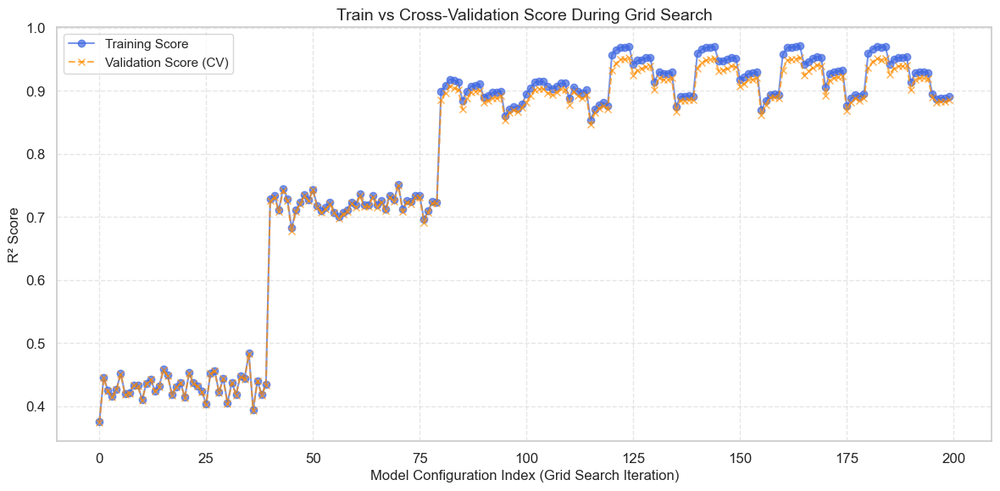

In [86]:

# Extract scores
test_scores = grid_search.cv_results_['mean_test_score']
train_scores = grid_search.cv_results_['mean_train_score'] 

# Plotting
plt.figure(figsize=(12, 6))
plt.plot(train_scores, label='Training Score', color='royalblue', linestyle='-', marker='o', alpha=0.7)
plt.plot(test_scores, label='Validation Score (CV)', color='darkorange', linestyle='--', marker='x', alpha=0.7)

plt.title('Train vs Cross-Validation Score During Grid Search', fontsize=14)
plt.xlabel('Model Configuration Index (Grid Search Iteration)', fontsize=12)
plt.ylabel('R² Score', fontsize=12)
plt.legend(loc='best', fontsize=11)
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


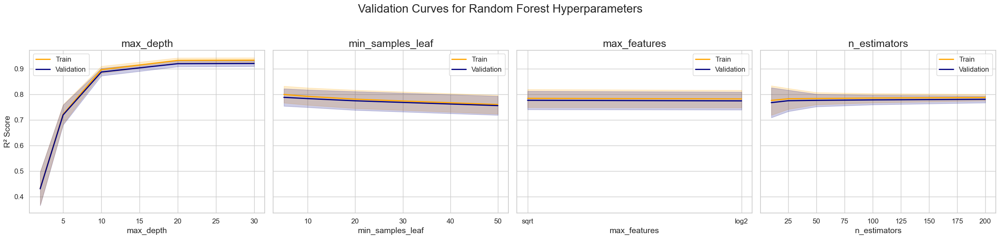

In [87]:
# Create DataFrame from GridSearch results
df = pd.DataFrame(grid_search.cv_results_)

# Metrics of interest
score_cols = ['mean_test_score', 'mean_train_score', 'std_test_score', 'std_train_score']

# Pooled standard deviation function
def pooled_std(stds, n=10):
    return np.sqrt(np.sum((n - 1) * (stds ** 2)) / ((len(stds)) * (n - 1)))

# Create subplots for each hyperparameter
fig, axes = plt.subplots(1, len(grid_params), figsize=(6 * len(grid_params), 6), sharey=True)
axes = axes if isinstance(axes, np.ndarray) else [axes]

for idx, (param, values) in enumerate(grid_params.items()):
    ax = axes[idx]
    ax.set_title(f'{param}', fontsize=18)
    ax.set_xlabel(param, fontsize=14)
    if idx == 0:
        ax.set_ylabel("R² Score", fontsize=14)

    # Group by current hyperparameter
    grouped = df.groupby(f'param_{param}')[score_cols].agg({
        'mean_train_score': 'mean',
        'mean_test_score': 'mean',
        'std_train_score': pooled_std,
        'std_test_score': pooled_std
    })

    # Plot training scores
    ax.plot(values, grouped['mean_train_score'], label='Train', color='orange', linewidth=2)
    ax.fill_between(values, 
                    grouped['mean_train_score'] - grouped['std_train_score'], 
                    grouped['mean_train_score'] + grouped['std_train_score'], 
                    color='orange', alpha=0.2)

    # Plot validation scores
    ax.plot(values, grouped['mean_test_score'], label='Validation', color='navy', linewidth=2)
    ax.fill_between(values, 
                    grouped['mean_test_score'] - grouped['std_test_score'], 
                    grouped['mean_test_score'] + grouped['std_test_score'], 
                    color='navy', alpha=0.2)

    ax.legend(loc='best')
    ax.grid(True)

plt.suptitle("Validation Curves for Random Forest Hyperparameters", fontsize=20)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


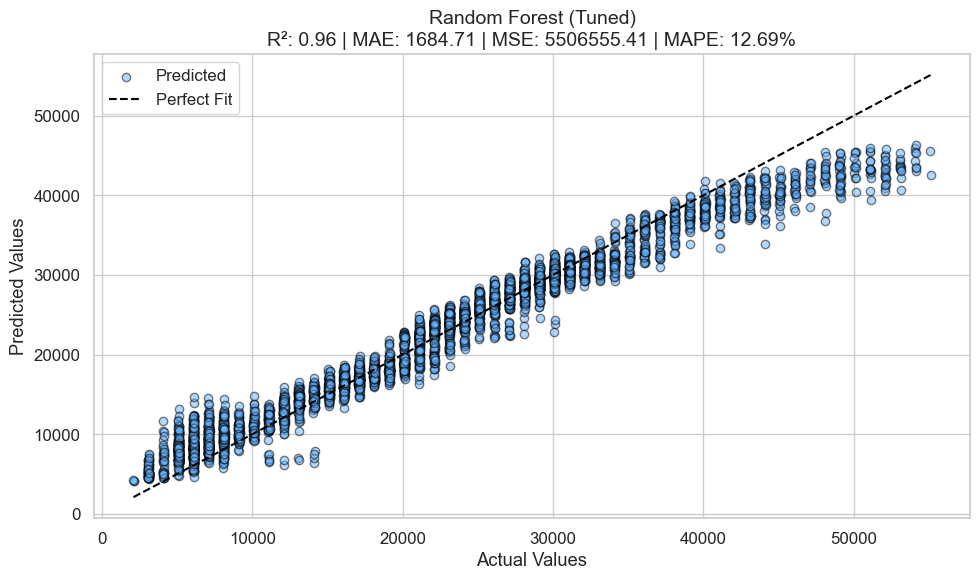

In [88]:

def model_metrics(y_true, y_pred):
    r2 = metrics.r2_score(y_true, y_pred)
    mae = metrics.mean_absolute_error(y_true, y_pred)
    mse = metrics.mean_squared_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / np.clip(np.abs(y_true), a_min=1e-8, a_max=None))) * 100
    return r2, mae, mse, mape

# Create and train best Random Forest model using best params
best_rf = RandomForestRegressor(
    bootstrap=True,
    max_depth=grid_search.best_params_['max_depth'],
    min_samples_leaf=grid_search.best_params_['min_samples_leaf'],
    n_estimators=grid_search.best_params_['n_estimators'],
    max_features=grid_search.best_params_['max_features'],
    random_state=42
)

best_rf.fit(X_train, y_train)
rf_best_pred = best_rf.predict(X_test)

# Compute metrics
r2, mae, mse, mape = model_metrics(y_test, rf_best_pred)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(y_test, rf_best_pred, alpha=0.5, color='#66b3ff', edgecolor='k', label='Predicted')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], '--', color='black', label='Perfect Fit')
plt.title(f"Random Forest (Tuned)\nR²: {r2:.2f} | MAE: {mae:.2f} | MSE: {mse:.2f} | MAPE: {mape:.2f}%", fontsize=14)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


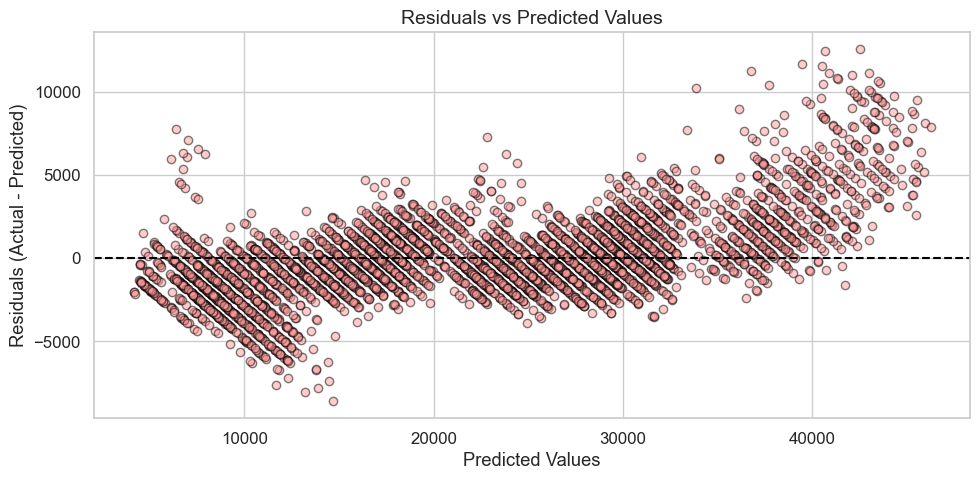

In [89]:
# Residual Plot
residuals = y_test - rf_best_pred

plt.figure(figsize=(10, 5))
plt.scatter(rf_best_pred, residuals, alpha=0.5, color='#ff9999', edgecolor='k')
plt.axhline(y=0, color='black', linestyle='--')
plt.title("Residuals vs Predicted Values", fontsize=14)
plt.xlabel("Predicted Values")
plt.ylabel("Residuals (Actual - Predicted)")
plt.grid(True)
plt.tight_layout()
plt.show()


**Gradient Boost - hypertuning**

In [90]:
grid_params = {
    
    'max_depth': [3, 7, 9],
    'n_estimators': [10, 25, 50, 100],
    'learning_rate': [0.0001, 0.001, 0.01, 0.1, 1.0],
    'subsample': [0.5, 0.7, 1.0]
}

# Instantiate the grid search model
grid_search = GridSearchCV(estimator = ensemble.GradientBoostingRegressor(), 
                           param_grid = grid_params, 
                           cv = 10,
                           n_jobs = -1,
                           verbose = 1, 
                           return_train_score=True)

# Fit the model
grid_search.fit(X_train, y_train)
print("Best score: ", grid_search.best_score_)
print("Best param: ", grid_search.best_params_)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best score:  0.9936377809810727
Best param:  {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 50, 'subsample': 1.0}


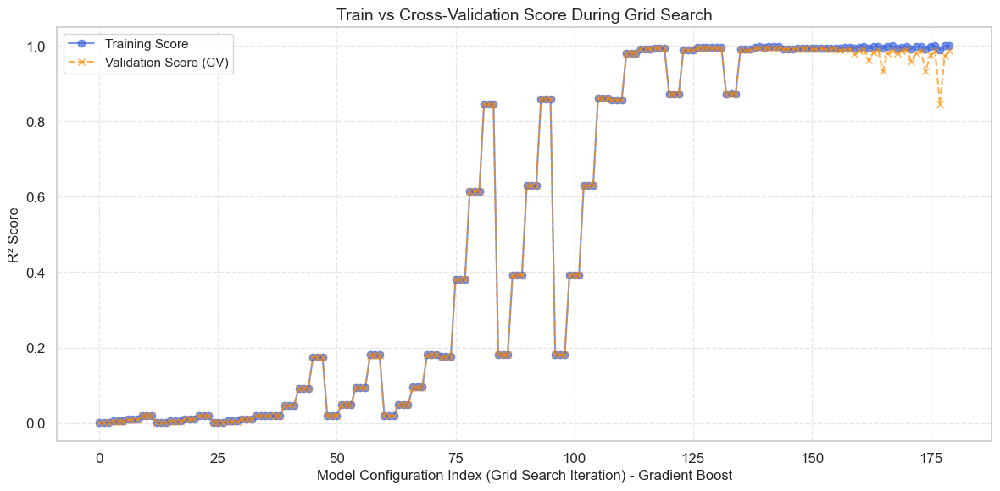

In [91]:

# Extract scores
test_scores = grid_search.cv_results_['mean_test_score']
train_scores = grid_search.cv_results_['mean_train_score'] 

# Plotting
plt.figure(figsize=(12, 6))
plt.plot(train_scores, label='Training Score', color='royalblue', linestyle='-', marker='o', alpha=0.7)
plt.plot(test_scores, label='Validation Score (CV)', color='darkorange', linestyle='--', marker='x', alpha=0.7)

plt.title('Train vs Cross-Validation Score During Grid Search', fontsize=14)
plt.xlabel('Model Configuration Index (Grid Search Iteration) - Gradient Boost', fontsize=12)
plt.ylabel('R² Score', fontsize=12)
plt.legend(loc='best', fontsize=11)
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


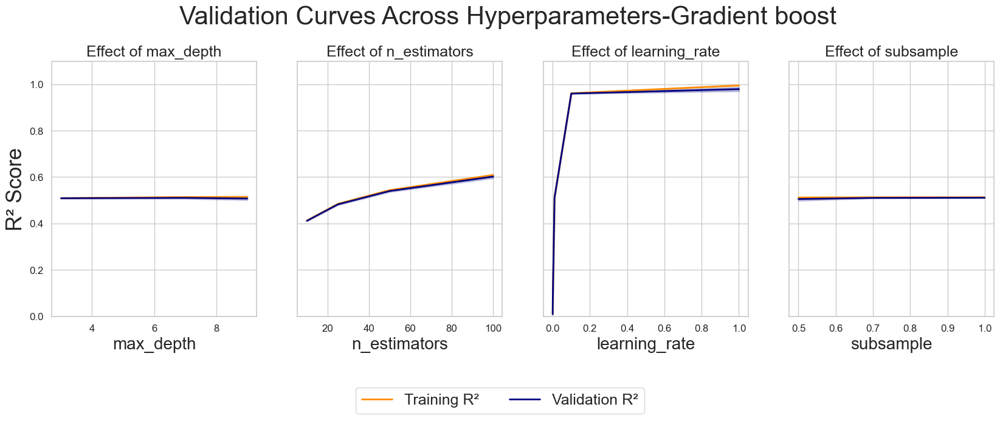

In [92]:

df = pd.DataFrame(grid_search.cv_results_)

# Step 2: Define the performance metrics to track
metrics = ['mean_test_score', 'mean_train_score', 'std_test_score', 'std_train_score']

# Step 3: Define pooled standard deviation function
def pooled_std(stds, n=10):  # n = number of folds in CV
    return np.sqrt(np.sum((n - 1) * (stds ** 2)) / ((len(stds)) * (n - 1)))

# Step 4: Prepare subplots (one per hyperparameter)
fig, axes = plt.subplots(1, len(grid_params), figsize=(5 * len(grid_params), 7), sharey=True)
axes = axes if isinstance(axes, np.ndarray) else [axes]

# General styling
line_width = 2
axes[0].set_ylabel("R² Score", fontsize=25)

# Step 5: Loop through each hyperparameter and plot its effect
for idx, (param_name, param_values) in enumerate(grid_params.items()):
    ax = axes[idx]
    ax.set_xlabel(param_name, fontsize=20)
    ax.set_ylim(0.0, 1.1)
    ax.set_title(f"Effect of {param_name}", fontsize=18)

    # Step 5a: Group by current hyperparameter values
    grouped = df.groupby(f'param_{param_name}')[metrics].agg({
        'mean_train_score': 'mean',
        'mean_test_score': 'mean',
        'std_train_score': pooled_std,
        'std_test_score': pooled_std
    })

    # Step 5b: Plot training score
    ax.plot(param_values, grouped['mean_train_score'], label="Training R²", color="darkorange", lw=line_width)
    ax.fill_between(param_values,
                    grouped['mean_train_score'] - grouped['std_train_score'],
                    grouped['mean_train_score'] + grouped['std_train_score'],
                    color="darkorange", alpha=0.2, lw=line_width)

    # Step 5c: Plot validation score
    ax.plot(param_values, grouped['mean_test_score'], label="Validation R²", color="navy", lw=line_width)
    ax.fill_between(param_values,
                    grouped['mean_test_score'] - grouped['std_test_score'],
                    grouped['mean_test_score'] + grouped['std_test_score'],
                    color="navy", alpha=0.2, lw=line_width)

# Step 6: Shared legend and title
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', ncol=2, fontsize=18)
fig.suptitle("Validation Curves Across Hyperparameters-Gradient boost", fontsize=30)

# Step 7: Adjust layout and show plot
fig.subplots_adjust(bottom=0.25, top=0.85)
plt.show()


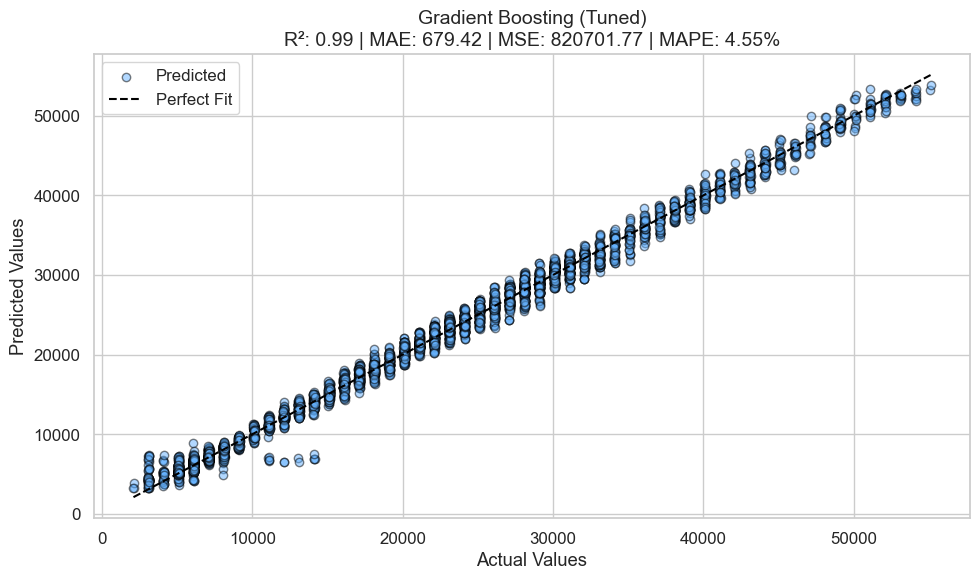

In [96]:
from sklearn import metrics
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import GradientBoostingRegressor


# Updated function to include MAPE
def model_metrics(y_true, y_pred):
    r2 = metrics.r2_score(y_true, y_pred)
    mae = metrics.mean_absolute_error(y_true, y_pred)
    mse = metrics.mean_squared_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / np.clip(np.abs(y_true), a_min=1e-8, a_max=None))) * 100
    return r2, mae, mse, mape

# Create and train best Gradient Boosting model using best params
best_gb = GradientBoostingRegressor(
    n_estimators=grid_search.best_params_['n_estimators'],
    learning_rate=grid_search.best_params_['learning_rate'],
    max_depth=grid_search.best_params_['max_depth'],
    subsample=grid_search.best_params_['subsample'],
    random_state=42
)

best_gb.fit(X_train, y_train)
gb_best_pred = best_gb.predict(X_test)

# Compute performance metrics
r2, mae, mse, mape = model_metrics(y_test, gb_best_pred)

# Plot actual vs predicted values with metrics in title
plt.figure(figsize=(10, 6))
plt.scatter(y_test, gb_best_pred, alpha=0.5, color='#66b3ff', edgecolor='k', label='Predicted')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], '--', color='black', label='Perfect Fit')
plt.title(f"Gradient Boosting (Tuned)\nR²: {r2:.2f} | MAE: {mae:.2f} | MSE: {mse:.2f} | MAPE: {mape:.2f}%", fontsize=14)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


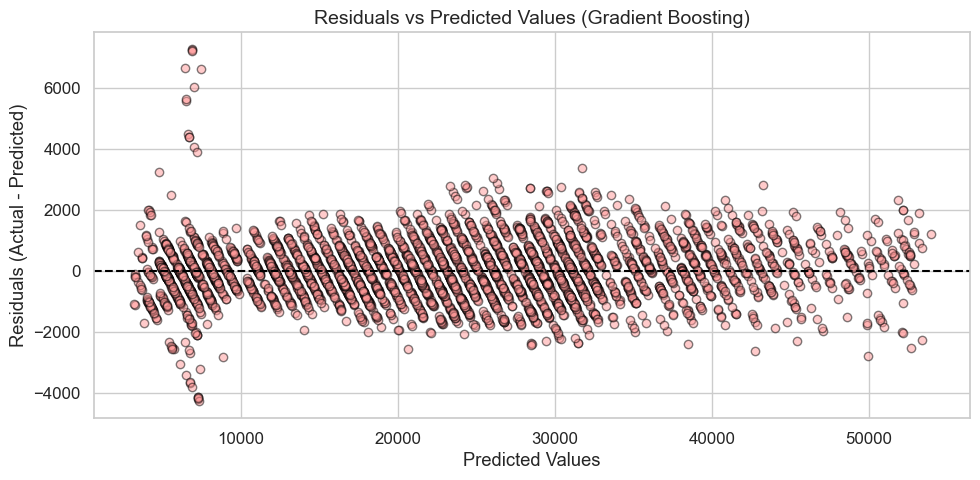

In [97]:
# Calculate residuals for Gradient Boosting predictions
residuals = y_test - gb_best_pred

plt.figure(figsize=(10, 5))
plt.scatter(gb_best_pred, residuals, alpha=0.5, color='#ff9999', edgecolor='k')
plt.axhline(y=0, color='black', linestyle='--')
plt.title("Residuals vs Predicted Values (Gradient Boosting)", fontsize=14)
plt.xlabel("Predicted Values")
plt.ylabel("Residuals (Actual - Predicted)")
plt.grid(True)
plt.tight_layout()
plt.show()


Ensemble Model Performance:
R²: 0.9847
MAE: 1077.8771
MSE: 2051260.7907
MAPE: 7.98%


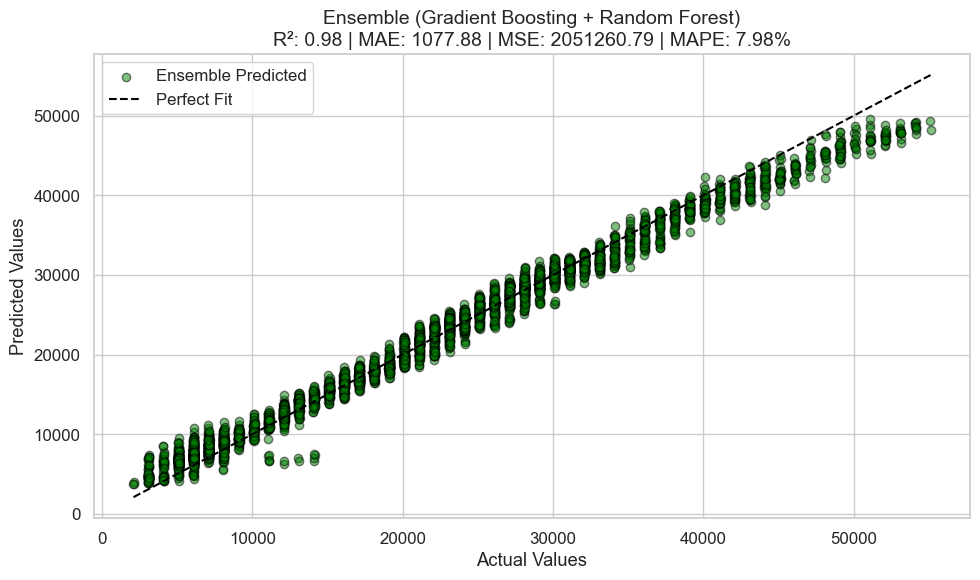

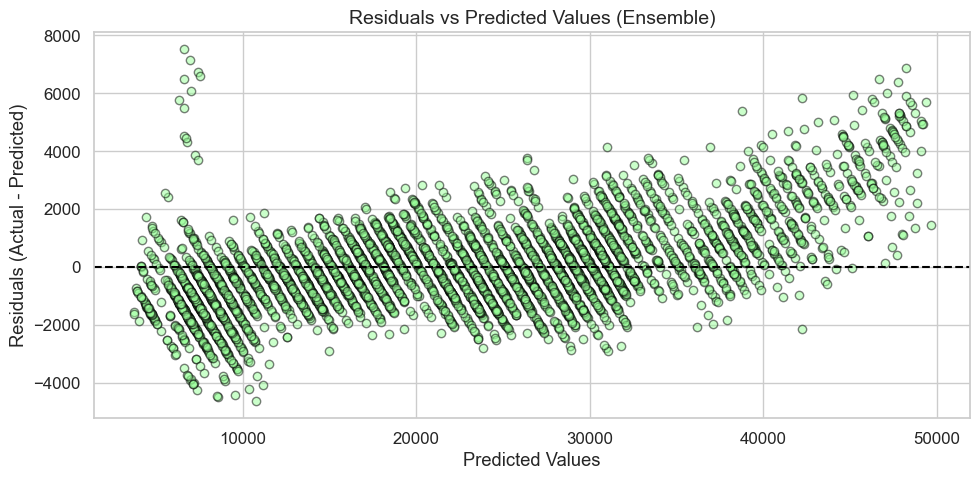

In [98]:

# Create ensemble predictions by averaging
ensemble_pred = (rf_best_pred + gb_best_pred) / 2

# Updated metric calculation function with MAPE
def model_metrics(y_true, y_pred):
    r2 = metrics.r2_score(y_true, y_pred)
    mae = metrics.mean_absolute_error(y_true, y_pred)
    mse = metrics.mean_squared_error(y_true, y_pred)
    mape = np.mean(np.abs((y_true - y_pred) / np.clip(np.abs(y_true), a_min=1e-8, a_max=None))) * 100
    return r2, mae, mse, mape

# Compute ensemble metrics
r2, mae, mse, mape = model_metrics(y_test, ensemble_pred)

# Print metrics
print(f"Ensemble Model Performance:\nR²: {r2:.4f}\nMAE: {mae:.4f}\nMSE: {mse:.4f}\nMAPE: {mape:.2f}%")

# Plot Actual vs Predicted for Ensemble
plt.figure(figsize=(10, 6))
plt.scatter(y_test, ensemble_pred, alpha=0.5, color='green', edgecolor='k', label='Ensemble Predicted')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], '--', color='black', label='Perfect Fit')
plt.title(f"Ensemble (Gradient Boosting + Random Forest)\nR²: {r2:.2f} | MAE: {mae:.2f} | MSE: {mse:.2f} | MAPE: {mape:.2f}%", fontsize=14)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Residual plot for Ensemble
residuals = y_test - ensemble_pred

plt.figure(figsize=(10, 5))
plt.scatter(ensemble_pred, residuals, alpha=0.5, color='#99ff99', edgecolor='k')
plt.axhline(y=0, color='black', linestyle='--')
plt.title("Residuals vs Predicted Values (Ensemble)", fontsize=14)
plt.xlabel("Predicted Values")
plt.ylabel("Residuals (Actual - Predicted)")
plt.grid(True)
plt.tight_layout()
plt.show()


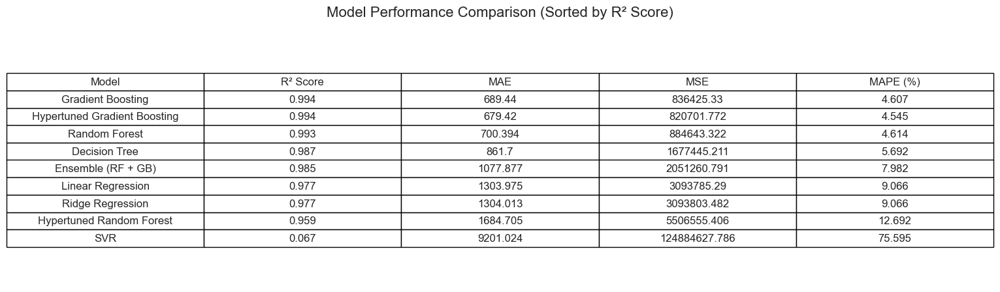

In [99]:


# List of model names and their predictions (original 6 models)
model_names = ['Linear Regression', 'Ridge Regression', 'Decision Tree', 
               'Random Forest', 'Gradient Boosting', 'SVR']

model_preds = [LR_predicted, R_predicted, DT_predicted, 
               RF_predicted, GB_predicted, S_predicted]

# Add hypertuned models
model_names += ['Hypertuned Random Forest', 'Hypertuned Gradient Boosting']
model_preds += [rf_best_pred, gb_best_pred]

# Add ensemble model (average of hypertuned RF and GB)
ensemble_pred = (rf_best_pred + gb_best_pred) / 2
model_names.append('Ensemble (RF + GB)')
model_preds.append(ensemble_pred)

# Collect evaluation metrics for all models including MAPE
results = []
for name, pred in zip(model_names, model_preds):
    r2 = metrics.r2_score(y_test, pred)
    mae = metrics.mean_absolute_error(y_test, pred)
    mse = metrics.mean_squared_error(y_test, pred)
    mape = np.mean(np.abs((y_test - pred) / np.clip(np.abs(y_test), a_min=1e-8, a_max=None))) * 100
    results.append({'Model': name, 'R² Score': r2, 'MAE': mae, 'MSE': mse, 'MAPE (%)': mape})

# Convert to DataFrame
results_df = pd.DataFrame(results)

# Round metrics for cleaner display
results_df = results_df.round(3)

# Sort by R² Score descending
results_df = results_df.sort_values(by='R² Score', ascending=False).reset_index(drop=True)

# Display results as a table
fig, ax = plt.subplots(figsize=(15, 5))
ax.axis('off')

table = ax.table(cellText=results_df.values,
                 colLabels=results_df.columns,
                 cellLoc='center',
                 loc='center')

table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.3, 1.6)

plt.title("Model Performance Comparison (Sorted by R² Score)", fontsize=16, pad=20)
plt.show()


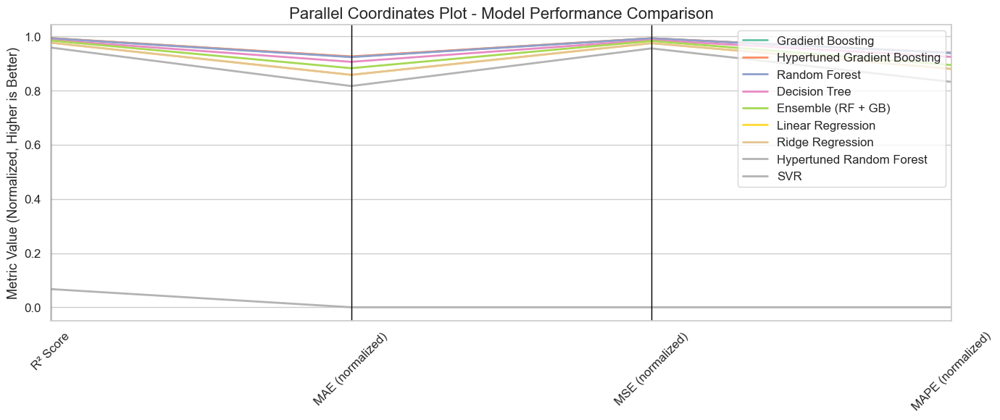

In [100]:
from pandas.plotting import parallel_coordinates


# Prepare a copy of the results dataframe
df_plot = results_df.copy()

# Normalize MAE, MSE, and MAPE so that higher is better (1 - relative to max value)
df_plot['MAE_norm'] = 1 - (df_plot['MAE'] / df_plot['MAE'].max())
df_plot['MSE_norm'] = 1 - (df_plot['MSE'] / df_plot['MSE'].max())
df_plot['MAPE_norm'] = 1 - (df_plot['MAPE (%)'] / df_plot['MAPE (%)'].max())

# Select columns to plot
df_plot = df_plot[['Model', 'R² Score', 'MAE_norm', 'MSE_norm', 'MAPE_norm']]

# Rename columns for better readability
df_plot = df_plot.rename(columns={
    'MAE_norm': 'MAE (normalized)',
    'MSE_norm': 'MSE (normalized)',
    'MAPE_norm': 'MAPE (normalized)'
})

# Plot
plt.figure(figsize=(14, 6))
parallel_coordinates(df_plot, class_column='Model', colormap='Set2', linewidth=2)

plt.title('Parallel Coordinates Plot - Model Performance Comparison', fontsize=16)
plt.ylabel('Metric Value (Normalized, Higher is Better)')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()
